In [1]:
import matplotlib.pyplot as plt
import numpy as np


from aart_func import *
import params
from params import * # The file params.py contains all the relevant parameters for the simulations
from astropy import units as u
import kgeo
import image_tools as tls
import subprocess
import scipy.interpolate
from scipy.interpolate import interp1d
import fileloading
import bigRunComputing
from matplotlib import ticker
from matplotlib.lines import Line2D

%load_ext autoreload
%autoreload 2
import importlib 
from functools import partial
import astroModels
import runDataClass
import classRunComputing
import subprocess
from matplotlib.patches import Circle
import kgeo
import numpy as np
from matplotlib import ticker


import EZPaths
import os

import astroPloting
import image_tools
from aart_func import *
from image_tools import curve_params
from params import *
import importlib
import params
import astroModels
import fileloading
from movieMakerV2 import movieMakerIntensity
import normalizingBrightparams
from astropy import units as u
import re

from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)
from movieMakerV2 import intensityBlurr

Welcome to eht-imaging! v 1.2.7 



/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/kgeo-0.0.1-py3.12.egg/kgeo/bfields.py:158: SyntaxWarning: invalid escape sequence '\m'
/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/kgeo-0.0.1-py3.12.egg/kgeo/bfields.py:183: SyntaxWarning: invalid escape sequence '\m'
/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/kgeo-0.0.1-py3.12.egg/kgeo/bfields.py:158: SyntaxWarning: invalid escape sequence '\m'
/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/kgeo-0.0.1-py3.12.egg/kgeo/bfields.py:183: SyntaxWarning: invalid escape sequence '\m'


In [2]:
def ring_convergance(xaxis,ring1,ring2, percent_diff):
    num_of_observation_points = 1000
    x1=xaxis[0]
    x2=xaxis[len(xaxis)-1]
    coords = np.linspace(x1, x2, num_of_observation_points)

    r1_interp = interp1d(xaxis, ring1)(coords)
    r2_interp = interp1d(xaxis, ring2)(coords)
    
    diff = np.abs((np.abs(r1_interp - r2_interp) / r1_interp) * 100)
    return coords, diff

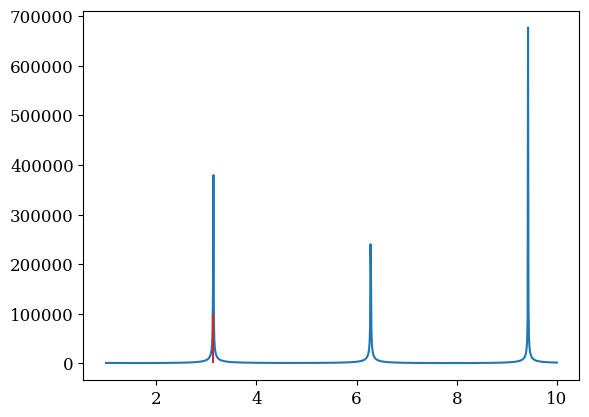

In [103]:
coords, diff =ring_convergance(x,y1,y2,2)
plt.plot(coords,diff)
plt.vlines(conv,-1,1e5,"tab:red")

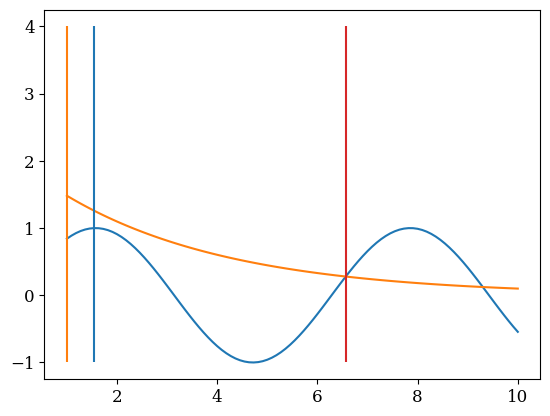

In [108]:
x=np.linspace(1,10,100)
y1=np.sin(x)
y2=2*np.exp(-.3*x)

plt.plot(x,y1,label="y1",color="tab:blue")
plt.plot(x,y2,color="tab:orange")

conv=ilp.ring_convergance(x,y1,y2,2)
peak1 = ilp.function_peak(x,y1)
peak2 = ilp.function_peak(x,y2)
plt.vlines(conv,-1,4,"tab:red")
plt.vlines(peak,-1,4,"tab:blue")
plt.vlines(peak2,-1,4,"tab:orange")


In [7]:
bigRunComputing.createIntensityArgs(astroModels.bp_run2)

' --nu [230000000000.0] --mass [1.3249659172847406e+43] --scaleh [0.5] --thetab [0.8726646259971648] --beta [1.0] --rie [10.0] --rb0 [5] --nth0 [19000.0] --te0 [100000000000.0] --b0 [5] --pdens [-0.7] --ptemp [-1.2, -1, -0.8] --pmag [-2, -1.5, -1] --nscale [0.4] --emodelkey 0 --bkey 2 --nnoisykey 0 --tnoisykey 0 --bnoisykey 0 '

# Initializing Data

In [3]:

run = runDataClass.run2

bigRun = classRunComputing.BigRuns(
    run.getRunName(),
    run.getBrightparams(),
    run.getBPVarNames(),
    run.getGeoGrid(),
    run.getGeoGridNames(),
    normalized_brightparams=run.getIsNormalized(),
)

full_bp_dict = bigRun.createBrightParamsDict()

ModelC22LowRez = runDataClass.SingleModelData(bigRun.getSubPaths(),run.getRunName(),"ModelC22") # Shallower, alpha_B = 1


run2 = runDataClass.soloRun2

bigRun2 = classRunComputing.BigRuns(
    run.getRunName(),
    run.getBrightparams(),
    run.getBPVarNames(),
    run.getGeoGrid(),
    run.getGeoGridNames(),
    normalized_brightparams=run.getIsNormalized(),
)

full_bp_dict2 = bigRun.createBrightParamsDict()


ModelC22HighRez = runDataClass.SingleModelData(bigRun.getSubPaths(),run.getRunName(),"ModelB1") # Shallower, alpha_B = 1



Subdirectory for storing all run results '/scratch/gpfs/td6241/aart/bigRuns/' already exist, doing nothing
Subdirectory for storing this run result '/scratch/gpfs/td6241/aart/bigRuns/run2/' already exist, doing nothing
Subdirectory for images '/scratch/gpfs/td6241/aart/bigRuns/run2/Images/' already exist, doing nothing
Subdirectory for data '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/' already exist, doing nothing
Subdirectory for inter model data '/scratch/gpfs/td6241/aart/bigRuns/run2/InterModel/' already exist, doing nothing
Subdirectory for  '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/geo/' already exist, doing nothing
Subdirectory for  '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/' already exist, doing nothing
Subdirectory for  '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/numpy/' already exist, doing nothing
Subdirectory for  '/scratch/gpfs/td6241/aart/bigRuns/run2/Images/fluxVNu/' already exist, doing nothing
Subdirectory for  '/scratch/gpfs/td6241/aart/bigRuns/run2/I

In [4]:
current_geo_model = fileloading.totalModelNametoGridModel("ModelC22",bigRun.run_type)
fileloading.loadGeoModel(current_geo_model, run.getRunName())



Loading ModelC

file /scratch/gpfs/td6241/aart/bigRuns/run2/geoModels/ModelC.py Loaded as /home/td6241/repo/aart/params.py


In [5]:
current_geo_model = fileloading.totalModelNametoGridModel("ModelC22",bigRun.run_type)

lband = bigRun.sub_paths["GeoDoth5Path"] + current_geo_model + "Lensing" + ".h5"
rtray = bigRun.sub_paths["GeoDoth5Path"] + current_geo_model + "RayTracing" + ".h5"


print("Reading file: ",lband)

h5f = h5py.File(lband,'r')

#Points for the boundary of the BH shadow
alpha_critc=h5f['alpha'][:]
beta_critc=h5f['beta'][:]

#The concave hulls for the lensing bands
hull_0i=h5f['hull_0i'][:]
hull_0e=h5f['hull_0e'][:]
hull_1i=h5f['hull_1i'][:]
hull_1e=h5f['hull_1e'][:]
hull_2i=h5f['hull_2i'][:]
hull_2e=h5f['hull_2e'][:]

#The grid points for each lensing band
supergrid0=h5f['grid0'][:]
N0=int(h5f["N0"][0])
mask0=h5f['mask0'][:]
lim0=int(h5f["lim0"][0])
supergrid1=h5f['grid1'][:]
N1=int(h5f["N1"][0])
mask1=h5f['mask1'][:]
lim1=int(h5f["lim1"][0])
supergrid2=h5f['grid2'][:]
N2=int(h5f["N2"][0])
mask2=h5f['mask2'][:]
lim2=int(h5f["lim2"][0])

h5f.close()


Reading file:  /scratch/gpfs/td6241/aart/bigRuns/run2/Data/geo/ModelCLensing.h5


# Meta Figure Data

In [6]:
freq_points = [86e9,230e9,345e9]
fig_home = "/home/td6241/results/aart/Figures/"

plt.rcParams.update({
    'font.size' : 14,                   # Set font size to 11pt
    'axes.labelsize': 14,               # -> axis labels
    'legend.fontsize': 12,              # -> legends
    'text.usetex': True,
    'text.latex.preamble': (            # LaTeX preamble
        r'\usepackage{lmodern}'
    ),
    'font.family': 'Latin Modern Roman',
})
n0_color = "#d55e00"
n1_color = "#0072b2"
n2_color = "#009e73"
cumu_color = "#cc79a7"


RingStyle ={
    "label": ['n=0','n=1','n=2','total'],
    "color": [n0_color,n1_color,n2_color,cumu_color],
    "linewidth": [3,3,3,4]
}
line_styles = {
    "lab_frame": "-",
    "rest_frame": "--",
    "thick":"-",
    "thin":"--"
}
xTickParams = {
    'length':15,
    'width': 1,
    'labelrotation': 0,
    'which':'major'
}

action = {
    "var": "nu0",
    "start": 10e9,
    "stop": 700e9,
    "step": 20e9,
    "images": True
}

conv_1_style = {
    "color": 'dimgrey',
    "linestyle": "-",
    "linewidth": 1
}
flux_peak_style = {
    "color": 'k',
    "linestyle": "-.",
    "linewidth": 2
}

r_outer_style = {
    "color": 'dimgrey',
    "linestyle": "-",
    "linewidth": 7
}

# Grid Creation

In [7]:
frequency_points = [86e9,230e9,345e9]
GeoLetter = "C"
model_name_list = np.array([["Model{}11".format(GeoLetter),"Model{}12".format(GeoLetter),"Model{}13".format(GeoLetter)],
                            ["Model{}21".format(GeoLetter),"Model{}22".format(GeoLetter),"Model{}23".format(GeoLetter)],
                            ["Model{}31".format(GeoLetter),"Model{}32".format(GeoLetter),"Model{}33".format(GeoLetter)]])
model_list = np.array([[None,None,None],[None,None,None],[None,None,None]])
model_bp_dict =  np.array([[None,None,None],[None,None,None],[None,None,None]])


for i in range(3):
    for j in range(3):
        model_bp_dict[i,j] = full_bp_dict[model_name_list[i,j]]
        model_bp_dict[i,j]["p_temp"] = -1 * model_bp_dict[i,j]["p_temp"]
        model_bp_dict[i,j]["p_mag"] = -1 * model_bp_dict[i,j]["p_mag"]
        model_list[i,j]= runDataClass.SingleModelData(bigRun.getSubPaths(),run.getRunName(),model_name_list[i,j],frequency_points)
        

In [8]:
#Frequency Grid
frequency = [90e9,230e9,350e9]
C22FullRadii = model_list[2,2]["radii_FullAbsorption_Thick"]
full_radii_thick = np.array([[None,None,None],[None,None,None],[None,None,None]])
full_radii_0 = np.array([[None,None,None],[None,None,None],[None,None,None]])
full_radii_1 = np.array([[None,None,None],[None,None,None],[None,None,None]])
full_radii_2 = np.array([[None,None,None],[None,None,None],[None,None,None]])



done_list = np.full(len(frequency_points), False)
increaseKList = np.full(3, False)
k = 0
for i in range(model_list[2,2]["radii_FullAbsorption_Thick"].shape[0]):
    current_freqeuncy = action['start'] + i * action['step']
    do_image, done_list = fileloading.frequencyListAnalysis(frequency_points, done_list, current_freqeuncy)
    for j in range(3):
        FullRadii = model_list[2,j]["radii_FullAbsorption_Thick"]
        Radii0 = model_list[2,j]["radii_I0_Thick"]
        Radii1 = model_list[2,j]["radii_I1_Thick"]
        Radii2 = model_list[2,j]["radii_I2_Thick"]
 

        if do_image:
            maxDone = np.argmin(increaseKList)
            
            val = not increaseKList[maxDone]
            if val:
                increaseKList[maxDone] = True
            else:
                increaseKList = np.full(3, False)
                k += 1
            print(increaseKList)
            print(current_freqeuncy/1e9)
          
            print("k: ",k)
            # print("j: ",j)
            print("_______")

            full_radii_thick[k,j] = FullRadii[i,:]
            full_radii_0[k,j] = Radii0[i,:]
            full_radii_1[k,j] = Radii1[i,:]
            full_radii_2[k,j] = Radii2[i,:]
            if not val:
                increaseKList[maxDone] = True
            
            

[ True False False]
90.0
k:  0
_______
[ True  True False]
90.0
k:  0
_______
[ True  True  True]
90.0
k:  0
_______
[False False False]
230.0
k:  1
_______
[ True  True False]
230.0
k:  1
_______
[ True  True  True]
230.0
k:  1
_______
[False False False]
350.0
k:  2
_______
[ True  True False]
350.0
k:  2
_______
[ True  True  True]
350.0
k:  2
_______


In [9]:
xaxis = np.array([[None,None,None],[None,None,None],[None,None,None]])
janksys_thin = np.array([[None,None,None],[None,None,None],[None,None,None]])
janksys_thick = np.array([[None,None,None],[None,None,None],[None,None,None]])
mean_radii_Thick = np.array([[None,None,None],[None,None,None],[None,None,None]])
mean_radii_Thin = np.array([[None,None,None],[None,None,None],[None,None,None]])
mean_optical_depth = np.array([[None,None,None],[None,None,None],[None,None,None]])
total_optical_depth = np.array([[None,None,None],[None,None,None],[None,None,None]])
theta = model_list[1,1]["theta"]

for i in range(3):
    for j in range(3):
        xaxis[i,j] = np.array(model_list[i,j]["x_variable"]) / astroModels.scale_label["nu0"]
        janksys_thin[i,j] = model_list[i,j]["janksys_thin"]
        janksys_thick[i,j] = model_list[i,j]["janksys_thick"]
        
        mean_radii_Thick[i,j] = model_list[i,j]["mean_radii_Thick"]
        mean_radii_Thin[i,j] = model_list[i,j]["mean_radii_Thin"]
        mean_optical_depth[i,j] = [model_list[i,j]["mean_optical_depth_I0"],model_list[i,j]["mean_optical_depth_I1"],model_list[i,j]["mean_optical_depth_I2"]]
        total_optical_depth[i,j] = model_list[i,j]["mean_optical_depth_Total"]

        
        

In [10]:
num_of_observation_points = 1000
coords = np.linspace(action["start"],670e9,num_of_observation_points) / 1e9

conv_1 = np.array([[None,None,None],[None,None,None],[None,None,None]])
flux_peak_thick = np.array([[None,None,None],[None,None,None],[None,None,None]])

percent_diff = 2
stop = 670e9
start = action["start"]
points = num_of_observation_points - 1
step = (stop - start)/points

for i in range(3):
    for j in range(3):
        cumu_interp = interp1d(xaxis[i,j], mean_radii_Thick[i,j][:, 3])(coords)
        n2_interp = interp1d(xaxis[i,j], mean_radii_Thick[i,j][:, 2])(coords)
        
        conv_1[i,j] = (start + step * ilp.ring_convergance(n2_interp, cumu_interp,percent_diff))/ astroModels.scale_label[action['var']]
        
        janksy_interp = interp1d(xaxis[i,j],janksys_thick[i,j][:, 3])(coords)
                
        flux_peak_thick[i,j] = (start + step * np.argmax(janksy_interp)) / astroModels.scale_label[action['var']]

TypeError: ring_convergance() missing 1 required positional argument: 'percent_diff'

In [11]:
# IS THIS ONLY DEPENDEND ON SPIN AND INC?
a = params.spin_case

inc = params.i_case * np.pi / 180  # inclination angle
rh = 1 + np.sqrt(1 - a ** 2)  # event horizon
# angles to sample
varphis = np.linspace(-180, 179, 360) * np.pi / 180

# generate inner shadow (n=0) curve with kgeo
data_inner = kgeo.equatorial_lensing.rho_of_req(a, inc, rh, mbar=0, varphis=varphis)
(_, rhos_inner, alphas_inner, betas_inner) = data_inner

r_inner = image_tools.curve_params(varphis, rhos_inner)

# generate outer shadow (n=inf) curve with kgeo
data_outer = kgeo.equatorial_lensing.rho_of_req(a, inc, rh, mbar=5, varphis=varphis)
(_, rhos_outer, alphas_outer, betas_outer) = data_outer

r_outer = image_tools.curve_params(varphis, rhos_outer)




# Power Laws


In [12]:
powerLawColors = {
    'shallow':'tab:red',
    'fiducial':'tab:orange',
    'steeper': 'tab:blue'
}

In [13]:
num_of_theta_points = 360
num_of_radial_points = 10000
def interp_of_theta(profile):
    x = np.arange(profile.shape[0])  # number of pixels
    y = x
    interp = RegularGridInterpolator((x, y), profile.T)
    theta = np.matrix(np.linspace(0, 2 * np.pi, num_of_theta_points,endpoint=False))  # 1 x num_of_theta_points

    rmax = profile.shape[0] * .4

    r = np.matrix(np.linspace(0, rmax, num_of_radial_points)).T  # num_of_radial_points x 1

    onest = np.matrix(np.ones(r.shape[0])).T  # (num_of_radial_points) x 1
    onesr = np.matrix(np.ones(num_of_theta_points))  # 1 x num_of_theta_points

    thetarray = onest @ theta  # (num_of_radial_points) x num_of_theta_points
    rarray = r @ onesr  # (num_of_radial_points) x num_of_theta_points

    xaart = np.multiply(rarray, np.cos(thetarray))
    yaart = np.multiply(rarray, np.sin(thetarray))

    # Convert to pixel coords from aart plot coords
    xprime = xaart + profile.shape[0] / 2
    yprime = yaart + profile.shape[0] / 2

    coords = np.array([xprime, yprime]).T
    return interp(coords), np.ravel(theta)

In [14]:
C21full_profiles = model_list[1,0]["0full_profiles0"]
C22full_profiles = model_list[1,1]["0full_profiles0"]
C23full_profiles = model_list[1,2]["0full_profiles0"]

C22full_profiles1 = model_list[1,1]["0full_profiles1"]
C22full_profiles2 = model_list[1,1]["0full_profiles2"]


In [15]:

C22brightparams = {
	"nu0": model_bp_dict[1,1]["nu0"]*ilp.Hz,				# 0
	"mass": model_bp_dict[1,1]["mass"]*ilp.grams,  		# 1
	"scale_height": model_bp_dict[1,1]["scale_height"],  		# 2
	"theta_b": model_bp_dict[1,1]["theta_b"]*ilp.rads,  	# 3
	"beta": model_bp_dict[1,1]["beta"],  				# 4
	"r_ie": model_bp_dict[1,1]["r_ie"], 					# 5
	"rb_0": model_bp_dict[1,1]["rb_0"],  					# 6
	"n_th0": model_bp_dict[1,1]["n_th0"]*ilp.cmcubed, 	# 7
	"t_e0": model_bp_dict[1,1]["t_e0"]*ilp.kelv,  		# 8
	"b_0": model_bp_dict[1,1]["b_0"]*ilp.gauss,		# 9
	"p_dens": model_bp_dict[1,1]["p_dens"],				# 10
	"p_temp": model_bp_dict[1,1]["p_temp"], 				# 11
	"p_mag": model_bp_dict[1,1]["p_mag"],  				# 12
	"nscale": model_bp_dict[1,1]["nscale"], 				# 13
}

r_array = np.logspace(np.log10(2), np.log10(50)) * u.dimensionless_unscaled

coords = {
    "r": r_array,
    "x": 1,
    "y": 1
}

specific_intensity_thin, specific_intensity_thick, tau, C22Restfull_profiles = ilp.rest_frame_thermal_profile(coords, bp=C22brightparams, fk=astroModels.funckeys)


In [16]:
# [r, theta_e.value, n.value, b_field.value, b_nu_fluid.value,
#                                     acoeff_I_fluid.value, tau_curve.value, jcoeff_I_fluid_packed.value]
theta_single = image_tools.rad_to_arg(np.pi)
r_variable = {
    "n0":C22full_profiles[0,:],
    "n1":C22full_profiles1[0,:],
    "n2":C22full_profiles2[0,:],
    "rest":C22Restfull_profiles[0,:]
}

jcoef = {
    "n0": C22full_profiles[7,:],
    "n1": C22full_profiles1[7,:],
    "n2": C22full_profiles2[7,:],
    "rest": C22Restfull_profiles[7,:]
}


r_variable["n0"],theta0 = interp_of_theta(r_variable["n0"].reshape(N0, N0).T)
r_variable["n1"],theta1 = interp_of_theta(r_variable["n1"].reshape(N1, N1).T)
r_variable["n2"],theta2 = interp_of_theta(r_variable["n2"].reshape(N2, N2).T)
# r_variable["rest"],theta2 = interp_of_theta(r_variable["rest"].reshape(N2, N2).T)

    
jcoef["n0"],theta0 = interp_of_theta(jcoef["n0"].reshape(N0, N0).T)
jcoef["n1"],theta1 = interp_of_theta(jcoef["n1"].reshape(N1, N1).T)
jcoef["n2"],theta2 = interp_of_theta(jcoef["n2"].reshape(N2, N2).T)
# jcoef["rest"],theta2 = interp_of_theta(jcoef["rest"].reshape(N2, N2).T)


for key in list(r_variable.keys()):
    if key != "rest":
        r_variable[key] = r_variable[key][theta_single]
        jcoef[key] = jcoef[key][theta_single]


    
    
    
theta_e = {
    "shallow": C23full_profiles[1,:],
    "fiducial": C22full_profiles[1,:],
    "steeper": C21full_profiles[1,:]
}

den = {
    "shallow": C23full_profiles[2,:],
    "fiducial": C22full_profiles[2,:],
    "steeper": C21full_profiles[2,:]
}

mag = {
    "shallow": C23full_profiles[3,:],
    "fiducial": C22full_profiles[3,:],
    "steeper": C21full_profiles[3,:]
}
    
theta_e["shallow"],theta0 = interp_of_theta(theta_e["shallow"].reshape(N0, N0).T)
theta_e["fiducial"],theta0 = interp_of_theta(theta_e["fiducial"].reshape(N0, N0).T)
theta_e["steeper"],theta0 = interp_of_theta(theta_e["steeper"].reshape(N0, N0).T)


den["shallow"],theta0 = interp_of_theta(den["shallow"].reshape(N0, N0).T)
den["fiducial"],theta0 = interp_of_theta(den["fiducial"].reshape(N0, N0).T)
den["steeper"],theta0 = interp_of_theta(den["steeper"].reshape(N0, N0).T)

mag["shallow"],theta0 = interp_of_theta(mag["shallow"].reshape(N0, N0).T)
mag["fiducial"],theta0 = interp_of_theta(mag["fiducial"].reshape(N0, N0).T)
mag["steeper"],theta0 = interp_of_theta(mag["steeper"].reshape(N0, N0).T)

for key in list(den.keys()):
    mag[key] = mag[key][theta_single]
    den[key] = den[key][theta_single]
    theta_e[key] = theta_e[key][theta_single]

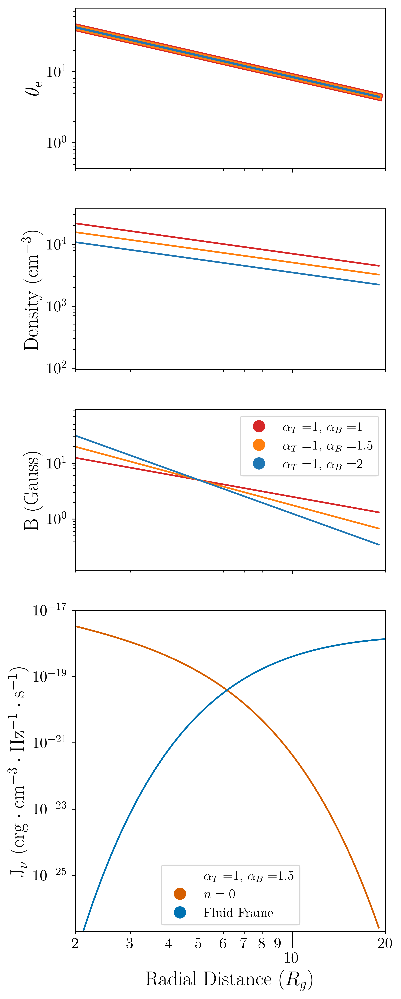

In [ ]:
fig = plt.subplots(4,1, sharex='col', figsize=(5,15), dpi=600, height_ratios=[1,1,1,2])
ax = [None, None, None, None]

i=0
n=70000

# Subplot 1-----------------------------------------
ax[0] = plt.subplot(4,1,1)
ax[0].plot(r_variable["n0"],theta_e["shallow"], powerLawColors['shallow'], linewidth=7)
ax[0].plot(r_variable["n0"],theta_e["fiducial"], powerLawColors['fiducial'], linewidth=5)
ax[0].plot(r_variable["n0"],theta_e["steeper"], powerLawColors['steeper'], linewidth=2)

ax[0].set_ylabel(R'$\rm \theta_e$', fontsize=18)
ax[0].set_yscale('log')

# Subplot 2-----------------------------------------
ax[1] = plt.subplot(4,1,2)
ax[1].plot(r_variable["n0"], den["shallow"], powerLawColors['shallow'])
ax[1].plot(r_variable["n0"], den["fiducial"], powerLawColors['fiducial'])
ax[1].plot(r_variable["n0"], den["steeper"], 'tab:blue')

ax[1].set_ylabel('Density ({})'.format(R'$\rm cm^{-3}$'), fontsize=18)
ax[1].set_yscale('log')

# Subplot 3-----------------------------------------
ax[2] = plt.subplot(4,1,3)


ax[2].plot(r_variable["n0"], mag["shallow"], powerLawColors['shallow'])
ax[2].plot(r_variable["n0"], mag["fiducial"], powerLawColors['fiducial'])
ax[2].plot(r_variable["n0"], mag["steeper"], powerLawColors['steeper'])

ax[2].set_yscale('log')
ax[2].set_ylabel('B (Gauss)', fontsize=18)

Legendlines = [
    Line2D([0],[0],marker='o', markerfacecolor=powerLawColors['shallow'], color='w', markersize=12),
    Line2D([0],[0],marker='o', markerfacecolor=powerLawColors['fiducial'], color='w', markersize=12),
    Line2D([0],[0],marker='o', markerfacecolor=powerLawColors['steeper'], color='w', markersize=12),
    # Line2D([0],[0],marker='o', markerfacecolor=ringColors[3], color='w', markersize=12),
]

Legendlabels = [
    R"$\alpha_T=$" + R"${}$".format(str(model_bp_dict[1,2]["p_temp"])) + R", $\alpha_B=$" + R"${}$".format(str(model_bp_dict[1,2]["p_mag"])),
    R"$\alpha_T=$" + R"${}$".format(str(model_bp_dict[1,1]["p_temp"])) + R", $\alpha_B=$" + R"${}$".format(str(model_bp_dict[1,1]["p_mag"])),
    R"$\alpha_T=$" + R"${}$".format(str(model_bp_dict[1,0]["p_temp"])) + R", $\alpha_B=$" + R"${}$".format(str(model_bp_dict[1,0]["p_mag"]))
    # "Total",
          ]


ax[2].legend(Legendlines,Legendlabels)

# Subplot 4-----------------------------------------
ax[3] = plt.subplot(4,1,4)


ax[3].plot(r_variable["n0"], jcoef["n0"], color=RingStyle["color"][0],linestyle=line_styles["lab_frame"])
ax[3].plot(r_variable["rest"], jcoef["rest"], color=RingStyle["color"][1],linestyle='-')
# ax[3].plot(r_variable["n2"], jcoef["n2"], color=RingStyle["color"][2],linestyle=line_styles["lab_frame"])


# ax[3].plot(bp0s["bp_shallowT86"][0,i::n], bp0s["bp_shallowT86"][7,i::n], 'tab:red',linewidth=3, label="Model 3",linestyle=(0, (1, 5)))
# ax[3].plot(bp0s["bp_fiducial86"][0,i::n], bp0s["bp_fiducial86"][7,i::n], 'tab:orange',linewidth=3,label="Model 1",linestyle=(0, (1, 5)))
# ax[3].plot(bp0s["bp_steeperT86"][0,i::n], bp0s["bp_steeperT86"][7,i::n], 'tab:blue',linewidth=3, label="Model 2",linestyle=(0, (1, 5)))


# ax[3].plot(bp0s["bp_shallowT345"][0,i::n], bp0s["bp_shallowT345"][7,i::n], 'tab:red', label="Model 3",linestyle='-.')
# ax[3].plot(bp0s["bp_fiducial345"][0,i::n], bp0s["bp_fiducial345"][7,i::n], 'tab:orange',label="Model 1",linestyle='-.')
# ax[3].plot(bp0s["bp_steeperT345"][0,i::n], bp0s["bp_steeperT345"][7,i::n], 'tab:blue', label="Model 2",linestyle='-.')


ax[3].set_ylabel(R'$\rm J_\nu$ ($\rm erg \cdot cm^{-3} \cdot Hz^{-1} \cdot s^{-1}$)', fontsize=18)
ax[3].set_yscale('log')
ax[3].set_xscale('log')
ax[3].minorticks_on()
ax[3].xaxis.set_major_formatter(ticker.FormatStrFormatter("%.0f"))
ax[3].xaxis.set_minor_formatter(ticker.FormatStrFormatter('%.0f'))
ax[3].set_xlabel('Radial Distance ({})'.format(R'$R_g$'), fontsize=18 )
ax[3].set_xlim([2,20])


Legendlines = [
    Line2D([0],[0],linestyle='-', markerfacecolor='k', color='w', markersize=12),
    Line2D([0],[0],marker='o', markerfacecolor=RingStyle["color"][0], color='w', markersize=12),
    Line2D([0],[0],marker='o', markerfacecolor=RingStyle["color"][1], color='w', markersize=12),
    # Line2D([0],[0],marker='o', markerfacecolor=RingStyle["color"][2], color='w', markersize=12),

    ]
Legendlabels = [
    R"$\alpha_T=$" + R"${}$".format(str(model_bp_dict[1,1]["p_temp"])) + R", $\alpha_B=$" + R"${}$".format(str(model_bp_dict[1,1]["p_mag"])),
    R"$n=0$",
    "Fluid Frame",
    # R"$n=2$",

          ]


ax[3].legend(Legendlines,Legendlabels)
ax[3].set_ylim([2e-27, 1e-17])
ax[3].tick_params('x', 
                  length=xTickParams["length"], 
                  width=xTickParams["width"], 
                  which=xTickParams["which"], 
                  labelrotation=xTickParams["labelrotation"])


# plt.savefig(fig_home + "emission_profiles.png", dpi=600, bbox_inches='tight')

# Flux Versus Observation Freq

In [176]:
RingStyle["linewidth"]=[3,3,3,2]

In [177]:
def createFluxRadiiGraph(ax,xaxis,janksys_thin,janksys_thick,fiducial_thin=None,fiducial_thick=None):

    ax.plot(xaxis, janksys_thin[:, 0], '-', label='n=0', color='tab:red', linewidth=3)
    janksky_line_style ={
        "label": ['n=0','n=1','n=2','total'],
        "color": [n0_color,n1_color,n2_color,cumu_color],
        "linewidth": [3,3,3,4]
    }

    amount_to_plot = 4
    

    if fiducial_thin is not None:
        for i in (range(amount_to_plot)):
            ax.plot(xaxis, 
                    fiducial_thin[:, i], 
                    line_styles["thin"],
                    label=RingStyle["label"][i], 
                    color=RingStyle["color"][i],
                    linewidth=RingStyle["linewidth"][i],
                    alpha=0.3)

            ax.plot(xaxis, fiducial_thick[:, i], 
                    line_styles["thick"],
                    label=RingStyle["label"][i], 
                    color=RingStyle["color"][i],
                    linewidth=RingStyle["linewidth"][i],
                    alpha=0.3)
            
    for i in (range(amount_to_plot)):
        ax.plot(xaxis, 
                janksys_thin[:, i], 
                line_styles["thin"],
                label=RingStyle["label"][i], 
                color=RingStyle["color"][i],
                linewidth=RingStyle["linewidth"][i])

        ax.plot(xaxis, 
                janksys_thick[:, i], 
                line_styles["thick"],
                label=RingStyle["label"][i], 
                color=RingStyle["color"][i],
                linewidth=RingStyle["linewidth"][i])
        


    # ax.axvline(poi["flux_peak_thin"], color=flux_peak_style["color"],
    #            linestyle=flux_peak_style["linestyle"], linewidth=flux_peak_style["linewidth"])

    # Labels

    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.xaxis.set_minor_formatter(ticker.FormatStrFormatter('%.0f'))
    ax.xaxis.set_major_formatter(ticker.FormatStrFormatter("%.0f"))
    # ax.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.1f'))
    # ax.yaxis.set_major_formatter(ticker.FormatStrFormatter("%.1f"))
    # ax1.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.4f'))
    # ax.yaxis.set_major_formatter(ticker.FormatStrFormatter("%.0e"))

    ax.tick_params('x', which="both", labelbottom=False)
    ax.tick_params('y', which="both", labelleft=False)

    n = 4  # Keeps every 4th label
    [l.set_visible(False) for (i, l) in enumerate(ax.xaxis.get_minorticklabels()) if i % n != 0]
    ax.tick_params('both', length=10, width=1, which='major')
    ax.set_xlim(xaxis[0], xaxis[xaxis.size - 1])
    ax.set_ylim(10e-5, 10e1)
    # ax.legend(loc='upper right')

    new_ticks = [xaxis[0], 230, xaxis[xaxis.size - 1]]
    ax.set_xticks(new_ticks)
    


    # ax.legend(Legendlines,Legendlabels)
    # ax.tick_params('x', length=10, width=1, which='major', labelrotation=90)


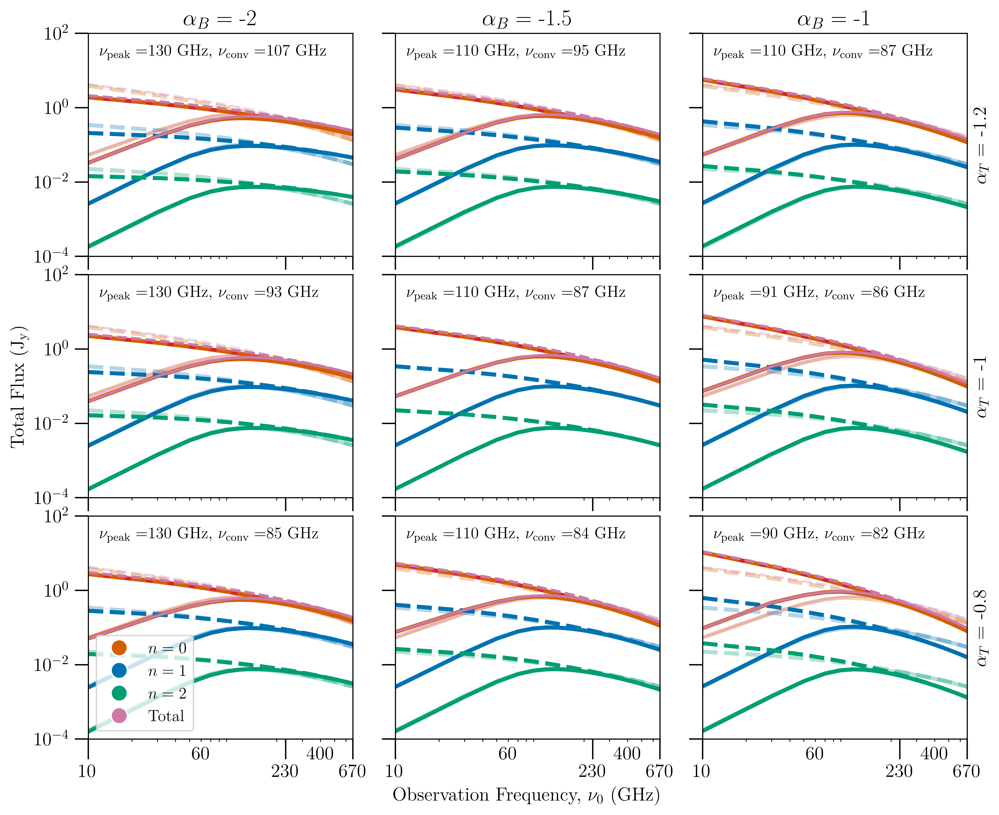

In [178]:

fig, ax = plt.subplots(3, 3, figsize=[10,8], dpi=600,sharex="col",sharey="row")
ax = np.array([[None, None, None],[None, None, None],[None, None, None]])
fig.tight_layout(h_pad=0.08,w_pad=1)

ploty = [1,4,7]
plotx = [7,8,9]

alphaBlabel = [1,2,3]
alphaTlabel = [3,6,9]

k = 1
fiducial_thin=janksys_thin[1,1]
fiducial_thick=janksys_thick[1,1]
for i in range(3):
    for j in range(3):
        # xaxis = np.array(model_list[i,j]["x_variable"]) / astroModels.scale_label["nu0"]
        # janksys_thin = model_list[i,j]["janksys_thin"]
        # janksys_thick = model_list[i,j]["janksys_thick"]
        #         xaxis = np.array(model_list[i,j]["x_variable"]) / astroModels.scale_label["nu0"]
        # janksys_thin = model_list[i,j]["janksys_thin"]
        # janksys_thick = model_list[i,j]["janksys_thick"]


        ax[i,j] = plt.subplot(3,3,k)
        createFluxRadiiGraph(
            ax[i,j],
            xaxis[i,j],
            janksys_thin[i,j],
            janksys_thick[i,j],
            fiducial_thin,
            fiducial_thick)
        
#         flux_peak = (action["start"] + action["step"] * np.argmax(janksys_thick[i, j]))/ astroModels.scale_label[action['var']]
# #         conv_1 = (action["start"] + action["step"] * ilp.ring_convergance(mean_radii_Thick[i,j][:, 2], mean_radii_Thick[i,j][:, 3],3)) / astroModels.scale_label[action['var']]
        
#         conv_1 = action["start"] + action["step"] * ilp.ring_convergance(mean_radii_Thick[i,j][:, 2], mean_radii_Thick[i,j][:, 3],3)
#         conv_1 = conv_1 / astroModels.scale_label[action['var']]
        
#         print(conv_1)
        
        text = R"$\nu_{\rm peak}=$" + str("{:.0f}".format(flux_peak_thick[i,j])) + ' ' + astroModels.units_label["nu0"]  + R", $\nu_{\rm conv}=$" + str("{:.0f}".format(conv_1[i,j])) + ' ' + astroModels.units_label["nu0"]
        ax[i,j].text(12, 25, text , fontsize=12, color="k")
        
        if k == 7:
            
            Legendlines = [
                Line2D([0],[0],marker='o', markerfacecolor=RingStyle["color"][0], color='w', markersize=12),
                Line2D([0],[0],marker='o', markerfacecolor=RingStyle["color"][1], color='w', markersize=12),
                Line2D([0],[0],marker='o', markerfacecolor=RingStyle["color"][2], color='w', markersize=12),
                Line2D([0],[0],marker='o', markerfacecolor=RingStyle["color"][3], color='w', markersize=12),
            ]
            Legendlabels = [
                R"$n=0$",
                R"$n=1$",
                R"$n=2$",
                "Total",
                  ]

            ax[i,j].legend(Legendlines,Legendlabels)
            
        if k == 4:
            ax[i,j].set_ylabel("Total Flux ({})".format(R'$\rm J_y$'))
        
        if k == 8:
            ax[i,j].set_xlabel(R"Observation Frequency, $\nu_0$ (GHz)")
            
        if k in ploty:
            ax[i,j].tick_params('y', which="both", labelleft=True)
        
        if k in plotx:
            ax[i,j].tick_params('x', which="both", labelbottom=True)
            
            
            n = 6  # Keeps every 4th label
            [l.set_visible(False) for (i, l) in enumerate(ax[i,j].xaxis.get_minorticklabels()) if i % n != 0]
            ax[i,j].tick_params('x', 
                  length=xTickParams["length"], 
                  width=xTickParams["width"], 
                  which=xTickParams["which"], 
                  labelrotation=xTickParams["labelrotation"])
            
        if k in alphaBlabel:
            ax[i,j].title.set_text(R'$\alpha_B=$ ' + str(model_bp_dict[i,j]["p_mag"]))
            
        if k in alphaTlabel:
            ax[i,j].set_ylabel(R'$\alpha_T=$ ' + str(model_bp_dict[i,j]["p_temp"]))
            ax[i,j].yaxis.set_label_position('right')
        k += 1
        
        
plt.savefig(fig_home + "FluxVRadGrid",dpi=600,bbox_inches='tight')

# Radii Vs Observation freq

In [313]:
def radiiVersusFreq(ax,xaxis,mean_radii,conv_1=None,flux_peak=None,r_outer=None):
    
    if conv_1 is not None:
        ax.axvline(conv_1,
                   color=conv_1_style["color"], 
                   linestyle=conv_1_style["linestyle"], 
                   linewidth=conv_1_style["linewidth"]
                  )
    
    if flux_peak is not None:
        ax.axvline(flux_peak, color=flux_peak_style["color"], 
                   linestyle=flux_peak_style["linestyle"], 
                   linewidth=flux_peak_style["linewidth"]
                  )
    
    if r_outer is not None:
        ax.axhline(r_outer,
                   color=r_outer_style["color"],
                   linestyle=r_outer_style["linestyle"], 
                   linewidth=r_outer_style["linewidth"],
                   alpha=0.3
                  )


    amount_to_plot = 4

    for i in reversed(range(amount_to_plot)):
        ax.plot(xaxis, mean_radii[:, i],
                 "-", 
                 label=RingStyle["label"][i],
                 color=RingStyle["color"][i], 
                 linewidth=RingStyle["linewidth"][i])


    # Labels
    # ax.set_xlabel(astroModels.var_label["nu0"].replace('=', '')
    #                + ' (' + astroModels.units_label["nu0"] + ')')
    ax.set_xscale('log')
    ax.set_yscale('log')

    ax.xaxis.set_minor_formatter(ticker.FormatStrFormatter('%.0f'))
    ax.xaxis.set_major_formatter(ticker.FormatStrFormatter("%.0f"))
    ax.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.1f'))
    ax.yaxis.set_major_formatter(ticker.FormatStrFormatter("%.1f"))

    new_ticks = [xaxis[0], 230, xaxis[xaxis.size - 1]]
    ax.set_xticks(new_ticks)

    # new_ticks = np.append(ax1.get_yticks(), r_outer)
    # new_ticks = np.append(new_ticks, r_inner)
    # print(new_ticks)
    # ax1.set_yticks(new_ticks)
    n = 4  # Keeps every 4th label
    [l.set_visible(False) for (i, l) in enumerate(ax.xaxis.get_minorticklabels()) if i % n != 0]
    ax.set_xlim(xaxis[0], xaxis[xaxis.size - 1])

#     ax.set_ylim(0, 6)
    
    ax.tick_params('x', which="both", labelbottom=False)
    ax.tick_params('y', which="both", labelleft=False)



    # ax.tick_params('x', length=20, width=1, which='major', labelrotation=80)

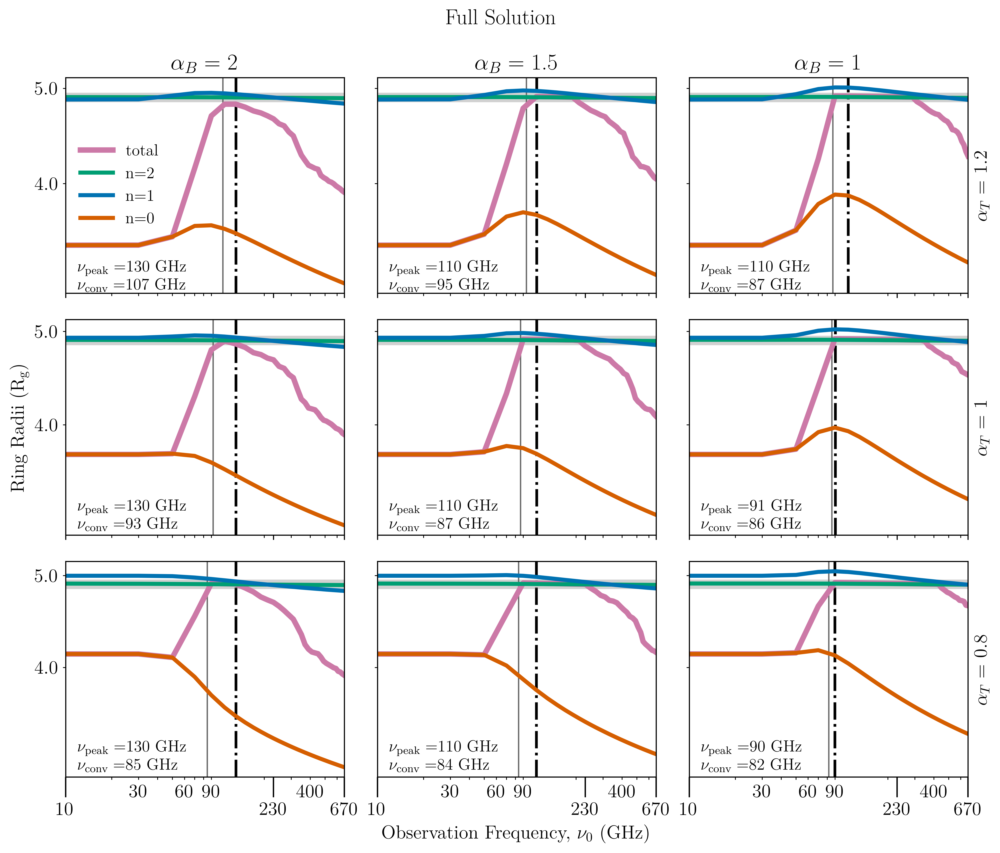

In [315]:

fig, ax = plt.subplots(3, 3, figsize=[10,8], dpi=600,sharex="col",sharey="row")
fig.suptitle('Full Solution', fontsize=16,y=1.03)
ax = np.array([[None, None, None],[None, None, None],[None, None, None]])
fig.tight_layout(pad=.5)

ploty = [1,4,7]
plotx = [7,8,9]

alphaBlabel = [1,2,3]
alphaTlabel = [3,6,9]

k = 1
for i in range(3):
    for j in range(3):
        
#         conv_1 = action["start"] + action["step"] * ilp.ring_convergance(mean_radii_Thick[i,j][:, 2], mean_radii_Thick[i,j][:, 3],3)
#         conv_1 = conv_1 / astroModels.scale_label[action['var']]
        
#         flux_peak_thick = action["start"] + action["step"] * np.argmax(janksys_thick[i,j][:, 3])
#         flux_peak_thick = flux_peak_thick / astroModels.scale_label[action['var']]

        

        ax[i,j] = plt.subplot(3,3,k)
        radiiVersusFreq(ax[i,j],
                        xaxis[i,j],
                        mean_radii_Thick[i,j],
                        conv_1[i,j],
                        flux_peak_thick[i,j],
                        r_outer
                       )
        if k == 4:
            ax[i,j].set_ylabel("Ring Radii ({})".format(R'$\rm R_g$'))
        
        text = R"$\nu_{\rm peak}=$" + str("{:.0f}".format(flux_peak_thick[i,j])) + ' ' + astroModels.units_label["nu0"] +"\n" + R" $\nu_{\rm conv}=$" + str("{:.0f}".format(conv_1[i,j])) + ' ' + astroModels.units_label["nu0"]
        props = dict(boxstyle='round', facecolor='white', alpha=0.5)
        
        if k == 1:
            ax[i,j].legend(frameon=False)
            # ax[i,j].text(12, 4.45, text , fontsize=12, color="k",bbox=props)

        ax[i,j].text(12, 3.12, text , fontsize=12, color="k")
            



        
        if k == 8:
            ax[i,j].set_xlabel(R"Observation Frequency, $\nu_0$ (GHz)")
            
        if k in ploty:
            ax[i,j].tick_params('y', which="both", labelleft=True)
        
        if k in plotx:
            ax[i,j].tick_params('x', which="both", labelbottom=True)
            n = 3  # Keeps every 4th label
            [l.set_visible(False) for (i, l) in enumerate(ax[i,j].xaxis.get_minorticklabels()) if i % n != 0]
            ax[i,j].tick_params('x', 
                  length=xTickParams["length"], 
                  width=xTickParams["width"], 
                  which=xTickParams["which"], 
                  labelrotation=xTickParams["labelrotation"])
            
        if k in alphaBlabel:
            ax[i,j].title.set_text(R'$\alpha_B=$ ' + str(model_bp_dict[i,j]["p_mag"]))
            
        if k in alphaTlabel:
            ax[i,j].set_ylabel(R'$\alpha_T=$ ' + str(model_bp_dict[i,j]["p_temp"]))
            ax[i,j].yaxis.set_label_position('right')

        k += 1
        
plt.savefig(fig_home + "ThickRadiiVNuGrid",dpi=600,bbox_inches='tight')

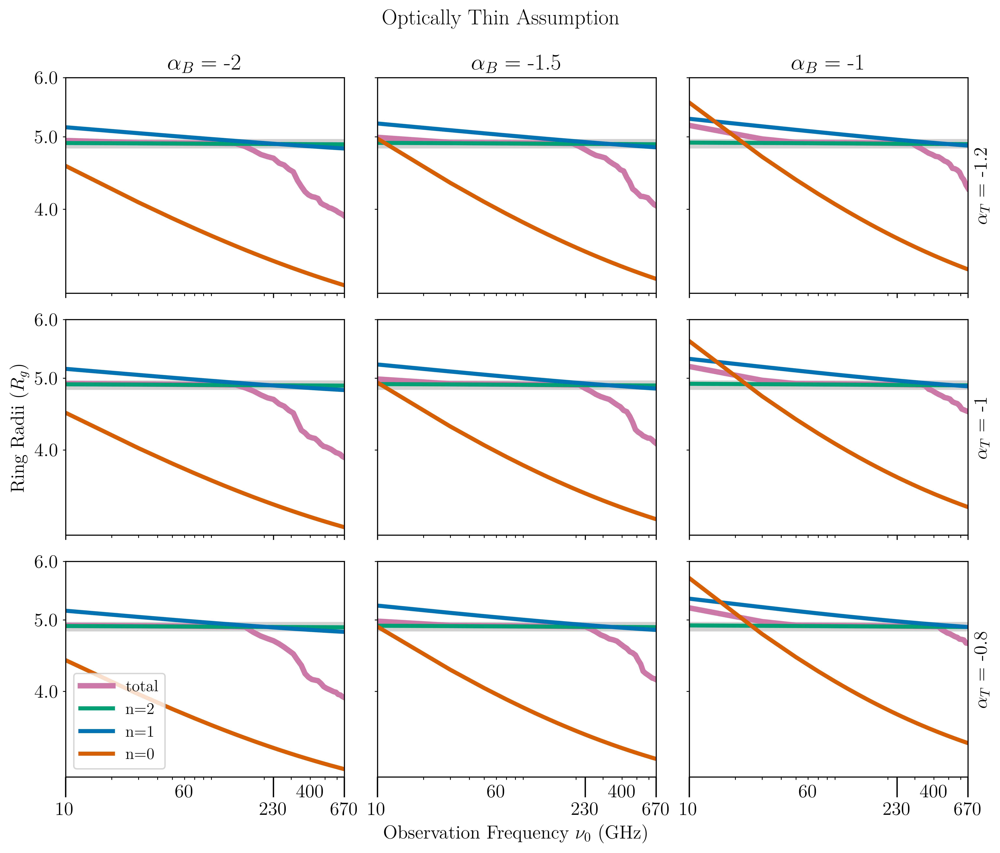

In [165]:

fig, ax = plt.subplots(3, 3, figsize=[10,8], dpi=600,sharex="col",sharey="row")
fig.suptitle('Optically Thin Assumption', fontsize=16,y=1.03)

ax = np.array([[None, None, None],[None, None, None],[None, None, None]])
fig.tight_layout(pad=.5)

ploty = [1,4,7]
plotx = [7,8,9]

alphaBlabel = [1,2,3]
alphaTlabel = [3,6,9]

k = 1
for i in range(3):
    for j in range(3):
        conv_1 = None



        ax[i,j] = plt.subplot(3,3,k)
        radiiVersusFreq(ax[i,j],
                xaxis[i,j],
                mean_radii_Thin[i,j],
               )
        if k == 4:
            ax[i,j].set_ylabel("Ring Radii ({})".format(R'$R_g$'))
            
        if k == 7:
            ax[i,j].legend(frameon=True)
        
        if k == 8:
            ax[i,j].set_xlabel(R"Observation Frequency, $\nu_0$ (GHz)")
            
        if k in ploty:
            ax[i,j].tick_params('y', which="both", labelleft=True)
        
        if k in plotx:
            ax[i,j].tick_params('x', which="both", labelbottom=True)
            n = 6  # Keeps every 4th label
            [l.set_visible(False) for (i, l) in enumerate(ax[i,j].xaxis.get_minorticklabels()) if i % n != 0]
            ax[i,j].tick_params('both', length=15, width=1, which='major')
            
        if k in alphaBlabel:
            ax[i,j].title.set_text(R'$\alpha_B=$ ' + str(model_bp_dict[i,j]["p_mag"]))
            
        if k in alphaTlabel:
            ax[i,j].set_ylabel(R'$\alpha_T=$ ' + str(model_bp_dict[i,j]["p_temp"]))
            ax[i,j].yaxis.set_label_position('right')
        
        k += 1
plt.savefig(fig_home + "ThinRadiiVNuGrid",dpi=600,bbox_inches='tight')

# Optical Depth

In [222]:
def optical_Depth(
    ax,
    xaxis,
    mean_optical_depth,
    total_optical_depth,
    fiducial_model,
    conv_1=None,
    flux_peak_thick=None
):
    
    ax.axvline(conv_1,
               color=conv_1_style["color"], linestyle=conv_1_style["linestyle"], linewidth=conv_1_style["linewidth"])
    
    
#     ax.axvline(flux_peak_thick, color=flux_peak_style["color"],
#                linestyle=flux_peak_style["linestyle"], linewidth=flux_peak_style["linewidth"])
    
    i = 0
    ax.plot(xaxis, 
            total_optical_depth,
            '-', 
            label=RingStyle["label"][i],
            color=RingStyle["color"][i], 
            linewidth=RingStyle["linewidth"][i]
           )
        
    ax.plot(xaxis, 
            fiducial_model,
            '-', 
            color=RingStyle["color"][i], 
            linewidth=RingStyle["linewidth"][i],
            alpha=.3
           )
    
#     for i in range(3):
#         ax.plot(xaxis, 
#                 mean_optical_depth[i],
#                 '-', 
#                 label=RingStyle["label"][i],
#                 color=RingStyle["color"][i], 
#                 linewidth=RingStyle["linewidth"][i]
#                )
        
#     for i in range(3):
#         ax.plot(xaxis, 
#                 fiducial_model[i],
#                 '-', 
#                 color=RingStyle["color"][i], 
#                 linewidth=RingStyle["linewidth"][i],
#                 alpha=.3
#                )


    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.axhline(
        1,
        linestyle='-',
        color='k',
        alpha=.3
    )
    ax.xaxis.set_minor_formatter(ticker.FormatStrFormatter('%.0f'))
    ax.xaxis.set_major_formatter(ticker.FormatStrFormatter("%.0f"))
    # ax.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.2f'))
    # ax.yaxis.set_major_formatter(ticker.FormatStrFormatter("%.2f"))

    if flux_peak_thick is not None:
        if np.abs(conv_1 - flux_peak_thick) > 35:
            new_ticks = [xaxis[0], 230, conv_1, flux_peak_thick, xaxis[xaxis.size - 1]]
        else:
            new_ticks = [xaxis[0], 230, flux_peak_thick, xaxis[xaxis.size - 1]]
    else:
        new_ticks = [xaxis[0], 230, xaxis[xaxis.size - 1]]
    ax.set_xticks(new_ticks)
    n = 6
    [l.set_visible(False) for (i, l) in enumerate(ax.xaxis.get_minorticklabels()) if i % n != 0]
    
    ax.set_xlim(xaxis[0], xaxis[xaxis.size - 1])



In [201]:
flux_peak_thick[i,j]

130.24024024024024

In [202]:
conv_1[i,j]

107.11711711711712

In [220]:
total_opticla_depth[i,j]

array(0.01998735)

In [219]:
xaxis[i,j]

array([ 10.,  30.,  50.,  70.,  90., 110., 130., 150., 170., 190., 210.,
       230., 250., 270., 290., 310., 330., 350., 370., 390., 410., 430.,
       450., 470., 490., 510., 530., 550., 570., 590., 610., 630., 650.,
       670.])

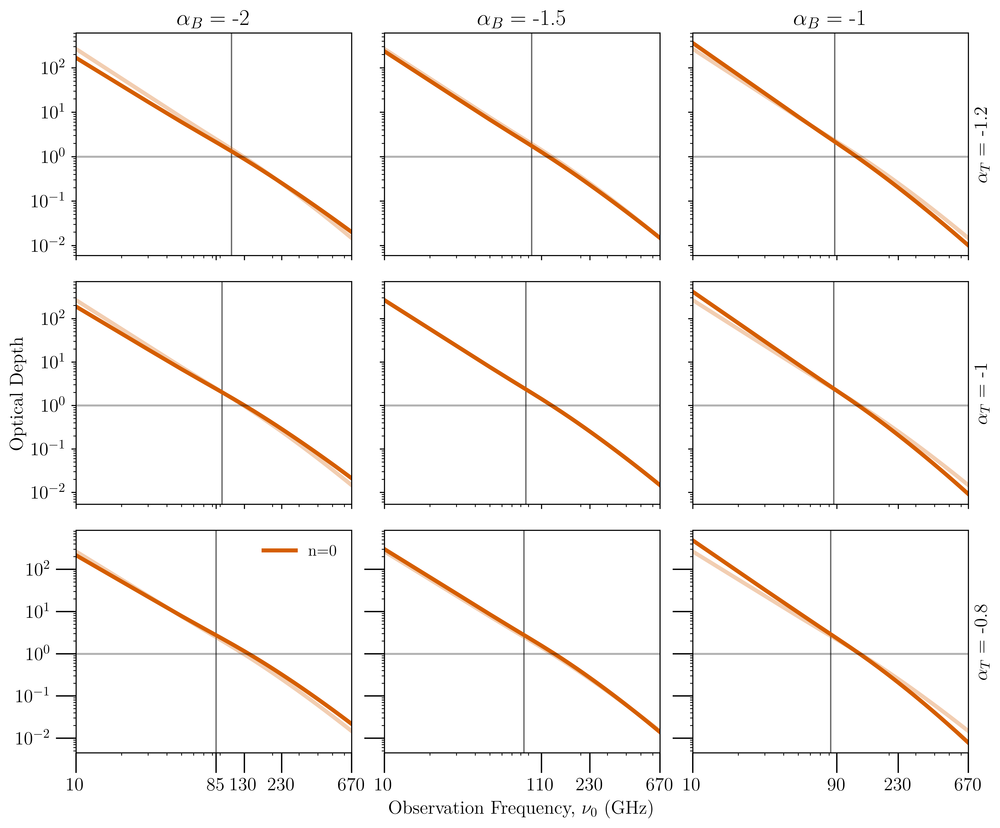

In [224]:
# fig, ax = plt.subplots(1, 1, figsize=[10,8], dpi=600,sharex="col",sharey="row")
# fig.suptitle('', fontsize=16,y=1.03)


fig, ax = plt.subplots(3, 3, figsize=[10,8], dpi=600,sharex="col",sharey="row")
ax = np.array([[None, None, None],[None, None, None],[None, None, None]])
fig.tight_layout(pad=.5)

ploty = [1,4,7]
plotx = [7,8,9]

alphaBlabel = [1,2,3]
alphaTlabel = [3,6,9]


fiducial_model=total_optical_depth[1,1]


k = 1
for i in range(3):
    for j in range(3):
#         poi = {
#             "r_outer": r_outer,
#             "flux_peak_thin": flux_peak_thin,
#             "flux_peak_thick":flux_peak_thick,
#             "conv_1": conv_1,
#         }
#         conv_1 = action["start"] + action["step"] * ilp.ring_convergance(mean_radii_Thick[i,j][:, 2], mean_radii_Thick[i,j][:, 3],3)
#         conv_1 = conv_1 / astroModels.scale_label[action['var']]


#         flux_peak_thick = action["start"] + action["step"] * np.argmax(janksys_thick[i,j][:, 3])
#         flux_peak_thick = flux_peak_thick / astroModels.scale_label[action['var']]


        ax[i,j] = plt.subplot(3,3,k)
        optical_Depth(
            ax[i,j],
            xaxis[i,j],
            mean_optical_depth[i,j],
            total_optical_depth[i,j],
            fiducial_model,
            conv_1[i,j],
            flux_peak_thick[i,j]
        )
        if k == 4:
            ax[i,j].set_ylabel("Optical Depth")
            
        if k == 7:
            ax[i,j].legend(frameon=False)
        
        if k == 8:
            ax[i,j].set_xlabel(R"Observation Frequency, $\nu_0$ (GHz)")
            
        if k in ploty:
            ax[i,j].tick_params('y', which="both", labelleft=True)
        
        if k in plotx:
            n = 6  # Keeps every 4th label
            [l.set_visible(False) for (i, l) in enumerate(ax[i,j].xaxis.get_minorticklabels()) if i % n != 0]
            ax[i,j].tick_params('both', 
                  length=xTickParams["length"], 
                  width=xTickParams["width"], 
                  which=xTickParams["which"], 
                  labelrotation=xTickParams["labelrotation"])
            
        if k in alphaBlabel:
            ax[i,j].title.set_text(R'$\alpha_B=$ ' + str(model_bp_dict[i,j]["p_mag"]))
            
        if k in alphaTlabel:
            ax[i,j].set_ylabel(R'$\alpha_T=$ ' + str(model_bp_dict[i,j]["p_temp"]))
            ax[i,j].yaxis.set_label_position('right')
        
        k += 1
# plt.savefig(fig_home + "OpticalDepthHighSpin",dpi=600,bbox_inches='tight')


# Full Images

In [106]:
def fullImage(ax,Absorbtion_Image,limit):
    vmax0 = np.nanmax(Absorbtion_Image)
        
    im = ax.imshow(Absorbtion_Image, vmax=vmax0, origin="lower", cmap="afmhot", extent=[-limit, limit, -limit, limit])


    ax.set_xlim(-10, 10)  # units of M
    ax.set_ylim(-10, 10)
    



    




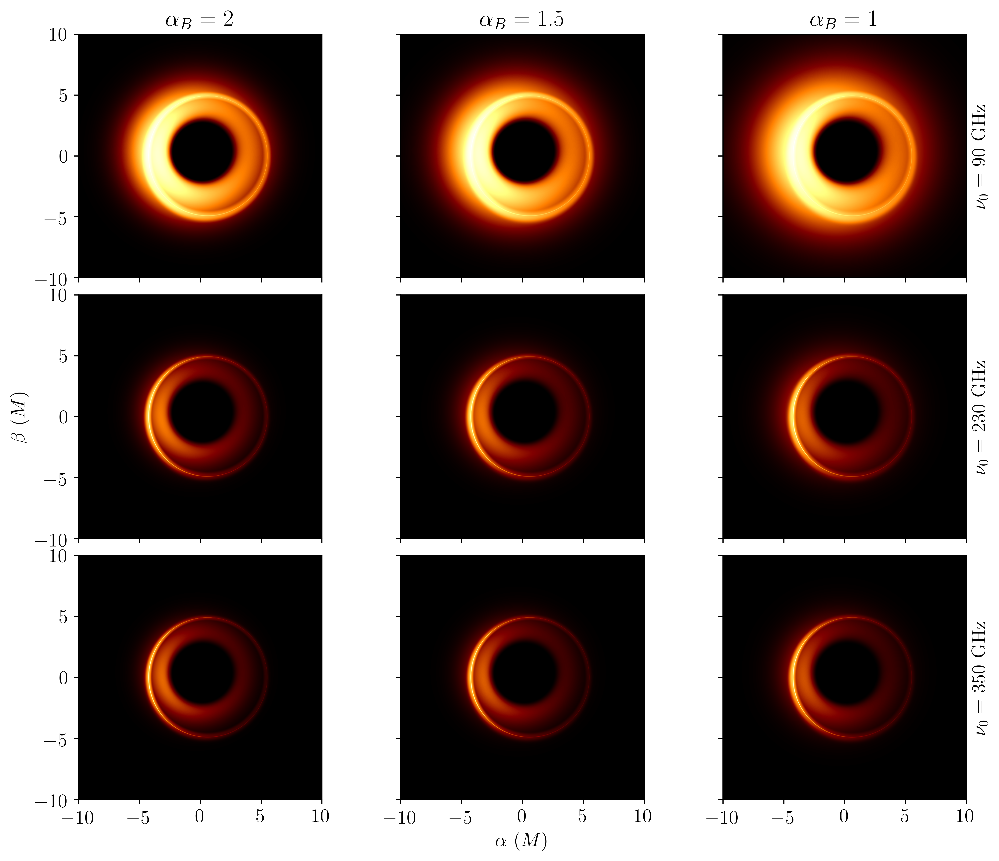

In [243]:
fig, ax = plt.subplots(3, 3, figsize=[10,8], dpi=600,sharex="col",sharey="row")
ax = np.array([[None, None, None],[None, None, None],[None, None, None]])
# thin_image = model_list[i,j]
fig.tight_layout(pad=0)
frequency = [90e9,230e9,350e9]

alphaBlabel = [1,2,3]
freq_label = [3,6,9]


k = 1
for i in range(3):
    current_freq = frequency[i]
    for j in range(3):
        filename = model_list[1,j].get_intensity_name(current_freq)
        
        h5f = h5py.File(filename, 'r')
        Absorbtion_Image = h5f['bghts_full_absorbtion'][:]
        h5f.close()
        
        
        ax[i,j] = plt.subplot(3,3,k)
        fullImage(
            ax[i,j],
            Absorbtion_Image,
            lim0)
        

        
        if k == 4:
            ax[i,j].set_ylabel(r"$\beta$" + " " + r"($M$)")

        if k == 8:
            ax[i,j].set_xlabel(r"$\alpha$" + " " + r"($M$)")
            
                    
        if k in alphaBlabel:
            ax[i,j].title.set_text(R'$\alpha_B=$ ' + str(model_bp_dict[1,j]["p_mag"]))
            
        if k in freq_label:
            ax[i,j].set_ylabel(R'$\nu_0=$ ' + "{:.0f}".format(current_freq / astroModels.scale_label[action["var"]]) + ' ' + astroModels.units_label[action["var"]])
            ax[i,j].yaxis.set_label_position('right')

        k += 1
    
        
            


        
        
    # ax.title.set_text('Optically Thin Assumption')
    # ax.text(-9, 8.5, astroModels.var_label[action["var"]]
    #      + str(round(frequency / astroModels.scale_label[action["var"]], 2))
    #      + ' ' + astroModels.units_label[action["var"]], fontsize=12, color="w")

plt.savefig(fig_home + "FullThickImages",dpi=600,bbox_inches='tight')

In [209]:
spinFullImage =  np.array([[None, None, None],[None, None, None],[None, None, None]])

# Spin 0 




h5f = h5py.File( '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelA22/clean/nu0_9.00000e+10', 'r')
spinFullImage[0,0] = h5f['bghts_full_absorbtion'][:]
h5f.close()

h5f = h5py.File( '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelA22/clean/nu0_2.30000e+11', 'r')
spinFullImage[0,1] = h5f['bghts_full_absorbtion'][:]
h5f.close()

h5f = h5py.File( '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelA22/clean/nu0_3.50000e+11', 'r')
spinFullImage[0,2] = h5f['bghts_full_absorbtion'][:]
h5f.close()
# Spin .5___________________________________________________________________________________________________________________


h5f = h5py.File( '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelB22/clean/nu0_9.00000e+10', 'r')
spinFullImage[1,0] = h5f['bghts_full_absorbtion'][:]
h5f.close()

h5f = h5py.File( '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelB22/clean/nu0_2.30000e+11', 'r')
spinFullImage[1,1] = h5f['bghts_full_absorbtion'][:]
h5f.close()

h5f = h5py.File( '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelB22/clean/nu0_3.50000e+11', 'r')
spinFullImage[1,2] = h5f['bghts_full_absorbtion'][:]
h5f.close()





# Spin 15/16___________________________________________________________________________________________________________________



h5f = h5py.File( '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelC22/clean/nu0_9.00000e+10', 'r')
spinFullImage[2,0] = h5f['bghts_full_absorbtion'][:]
h5f.close()

h5f = h5py.File( '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelC22/clean/nu0_2.30000e+11', 'r')
spinFullImage[2,1] = h5f['bghts_full_absorbtion'][:]
h5f.close()

h5f = h5py.File( '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelC22/clean/nu0_3.50000e+11', 'r')
spinFullImage[2,2] = h5f['bghts_full_absorbtion'][:]
h5f.close()




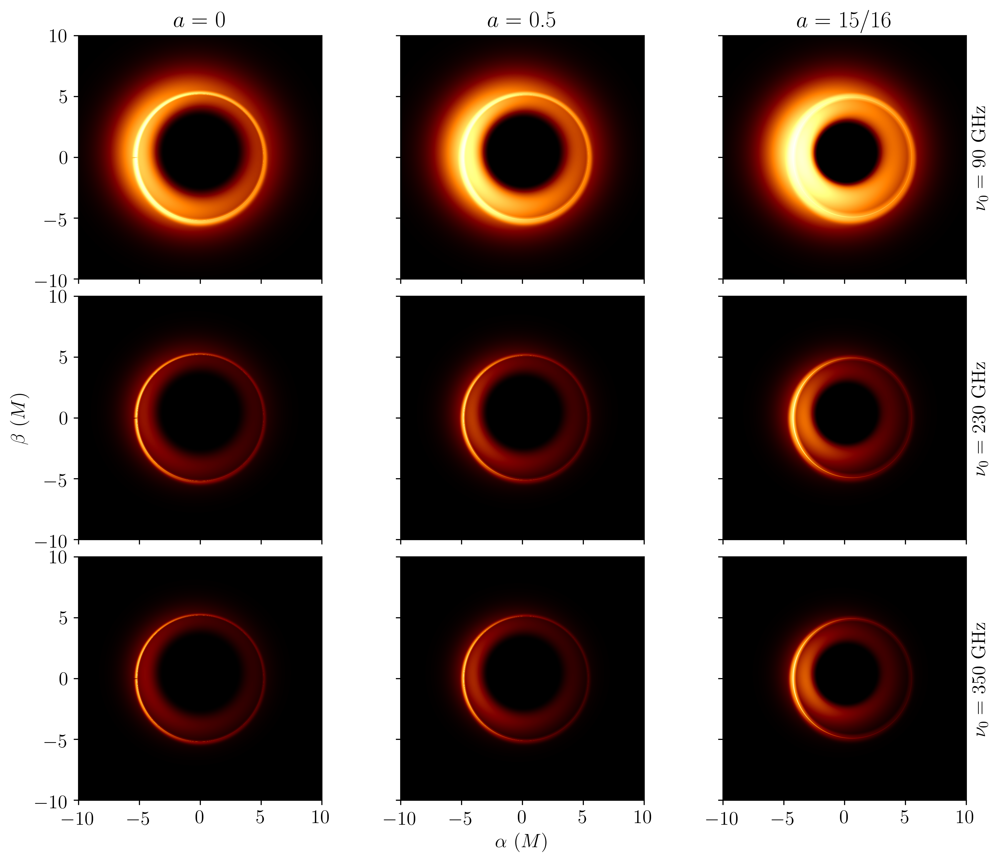

In [210]:
fig, ax = plt.subplots(3, 3, figsize=[10,8], dpi=600,sharex="col",sharey="row")
ax = np.array([[None, None, None],[None, None, None],[None, None, None]])
# thin_image = model_list[i,j]
fig.tight_layout(pad=0)
frequency = [90e9,230e9,350e9]
spins = ["0","0.5","15/16"]
alphaBlabel = [1,2,3]
freq_label = [3,6,9]

k = 1
for i in range(3):
    current_freq = frequency[i]
    for j in range(3):
        
        ax[i,j] = plt.subplot(3,3,k)
        fullImage(
            ax[i,j],
            spinFullImage[j,i],
            lim0)
        

        
        if k == 4:
            ax[i,j].set_ylabel(r"$\beta$" + " " + r"($M$)")

        if k == 8:
            ax[i,j].set_xlabel(r"$\alpha$" + " " + r"($M$)")
            
                    
        if k in alphaBlabel:
            ax[i,j].title.set_text(R'$a=$ ' + spins[j])
            
        if k in freq_label:
            ax[i,j].set_ylabel(R'$\nu_0=$ ' + "{:.0f}".format(current_freq / astroModels.scale_label[action["var"]]) + ' ' + astroModels.units_label[action["var"]])
            ax[i,j].yaxis.set_label_position('right')

        k += 1
    
        
            


        
        
    # ax.title.set_text('Optically Thin Assumption')
    # ax.text(-9, 8.5, astroModels.var_label[action["var"]]
    #      + str(round(frequency / astroModels.scale_label[action["var"]], 2))
    #      + ' ' + astroModels.units_label[action["var"]], fontsize=12, color="w")

plt.savefig(fig_home + "SpinFullThickImages",dpi=600,bbox_inches='tight')

# Radii Calc

In [161]:
def jy(I, nu, mass):
    """Calculate totalt jasnky flux of a photon ring

    Args:
        I (ndarray): Ndarray of brightness temperature values
        nu (Float): Observation frequency
        mass (Float): Black hole mass

    Returns:
        _type_: _description_
    """
    I = I * u.K
    nu = nu * u.Hz
    mass = mass * u.g
    one_M = ilp.rg_func(mass).to(u.m)
    M2rads = np.arctan(one_M.value / dBH)
    rads2pxls = (M2rads * 2 * limits) / I.shape[0]  # total amount M length units rads / total pixels
    return (I * nu ** 2 * (2 * ilp.kB / ilp.c ** 2)).to(u.Jy)* rads2pxls ** 2  # was this orifianlly in per radians?


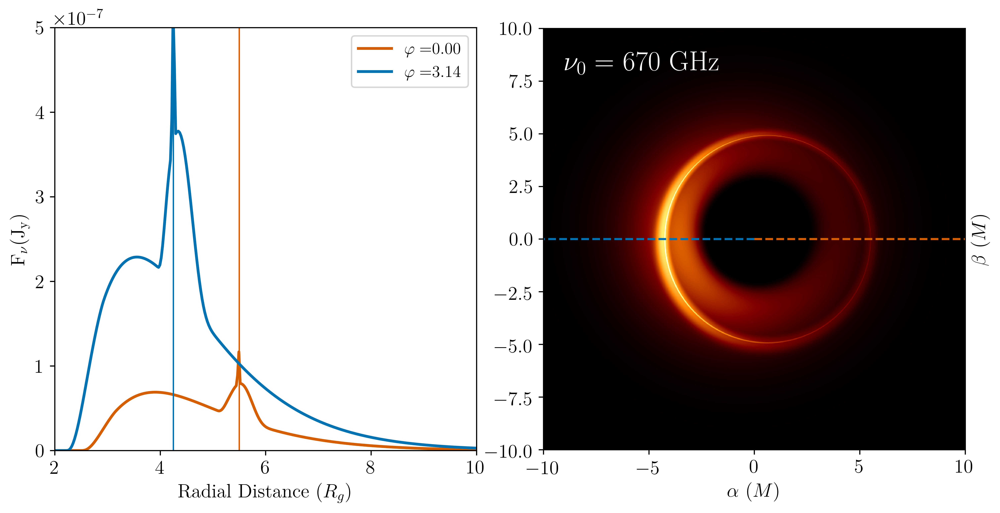

In [166]:
current_freq = 230e9
fig, (ax,ax1) = plt.subplots(1, 2, figsize=[10,5], dpi=600)
fig.tight_layout(h_pad=.8)
filename = model_list[2,2].get_intensity_name(current_freq)

h5f = h5py.File(filename, 'r')
Absorbtion_Image = h5f['bghts_full_absorbtion'][:]
h5f.close()

limit=lim0


images = Absorbtion_Image
rsize = image_tools.num_of_radial_points
rmax = images.shape[0] * .4



# axes_0[J].get_xaxis().set_ticks([])
# axes_1[J].get_xaxis().set_ticks([])
peakAbsorb, interpAbsorb = image_tools.radii_of_thetaV2_data(images)
peaks = peakAbsorb
interps = interpAbsorb
x = np.linspace(0, rmax - 1, rsize) * params.dx0
ptheta = [0, np.pi]
colors = [RingStyle["color"][0], RingStyle["color"][1], 'tab:red']
parg = []
for L in range(len(ptheta)):
    parg += [image_tools.rad_to_arg(ptheta[L])]
    
    
    yplt = jy(interps[parg[L]], current_freq, model_bp_dict[1,1]["mass"])
    ax.plot(x, yplt, linewidth=2, color=colors[L],
                   label=R"$\varphi= $" + f"{ptheta[L]:.2f}")
    ax.axvline(peaks[parg[L]], color=colors[L],
               linewidth=1)

# ax.set_xlim([2, 6])
ax.legend()
ax.set_xlabel(R"Radial Distance ($R_g$)")
ax.set_xlim(2, 10)
ax.set_ylim(0, 5e-7)


# ax.set_ylabel(R"Flux" + R"($r_g, \varphi$)" +  R"$(\rm J_y)$")
ax.set_ylabel(R"$\rm F_\nu$" +  R"$(\rm J_y)$")

im1 = ax1.imshow(images, origin="lower", cmap="afmhot", extent=[-limit, limit, -limit, limit])

ax1.set_xlim(-10, 10)  # units of M
ax1.set_ylim(-10, 10)

ax1.set_xlabel(r"$\alpha$" + " " + r"($M$)")
ax1.set_ylabel(r"$\beta$" + " " + r"($M$)")
ax1.yaxis.set_label_position("right")
ax1.text(-9, 8, R"$\nu_0=$ 670 GHz" , fontsize=20, color="white")
# Plot lines
rline1 = np.array([0, 10])
theta1 = np.array([0, 0])

alpha1 = rline1 * np.cos(theta1)
beta1 = rline1 * np.sin(theta1)

for L in range(len(ptheta)):
    rline = np.array([0, 10])
    theta = np.array([ptheta[L], ptheta[L]])

    alpha = rline * np.cos(theta)
    beta = rline * np.sin(theta)

    ax1.plot(alpha, beta, color=colors[L], linestyle='--')
    

# colorbar0 = fig.colorbar(im1, fraction=0.046, pad=0.04, format='%.1e', ticks=[
#     vmax * .8,
#     vmax * .6,
#     vmax * .4,
#     vmax * .2,
#     vmax * .05
# ],
#                          label="Brightnes Temperature (K)",
#                          ax=ax1
#                          )

plt.savefig(fig_home + "FluxVRadSingle",dpi=600,bbox_inches='tight')

# RADII CONV

In [87]:
pathHighRez = '/scratch/gpfs/td6241/aart/bigRuns/soloRun2/Data/intensity/ModelB1/clean/nu0_6.70000e+11'
h5f = h5py.File(pathHighRez, 'r')
Thin_ImageHighRez  = [
    h5f['bghts0'][:],
    h5f['bghts1'][:],
    h5f['bghts2'][:],
    h5f['bghts0'][:] + h5f['bghts1'][:] + h5f['bghts2'][:]
                     ]
h5f.close()

pathLowRez = '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelC22/clean/nu0_6.70000e+11'
h5f = h5py.File(pathLowRez, 'r')
Thin_ImageLowRez  = [
    h5f['bghts0'][:],
    h5f['bghts1'][:],
    h5f['bghts2'][:],
    h5f['bghts0'][:] + h5f['bghts1'][:] + h5f['bghts2'][:]
                     ]
h5f.close()



In [88]:
vmax = np.nanmax(Thin_ImageHighRez[3]) * 1.2

In [92]:
def radiiVSVarphi(fig,ax0,ax1,limit,thin_intensity,blurr_policy=False,plot_intensites=False,average=True,color_bar=False):
    if plot_intensites:
        peak0, theta0, intent_at_peaks0 = image_tools.radii_of_thetaV2(thin_intensity[0],
                                                                       give_intensities=True,average=average)
        peak1, theta1, intent_at_peaks1 = image_tools.radii_of_thetaV2(thin_intensity[1],
                                                                       give_intensities=True,average=average)
        peak2, theta2, intent_at_peaks2 = image_tools.radii_of_thetaV2(thin_intensity[2],
                                                                       give_intensities=True,average=average)
        peak3, theta3, intent_at_peaks3 = image_tools.radii_of_thetaV2(thin_intensity[3],
                                                                       give_intensities=True,average=average)
        intent_at_peaks = [intent_at_peaks0, intent_at_peaks1, intent_at_peaks2, intent_at_peaks3]
    else:
        peak0, theta0 = image_tools.radii_of_thetaV2(thin_intensity[0],average=average)
        peak1, theta1 = image_tools.radii_of_thetaV2(thin_intensity[1],average=average)
        peak2, theta2 = image_tools.radii_of_thetaV2(thin_intensity[2],average=average)
        peak3, theta3 = image_tools.radii_of_thetaV2(thin_intensity[3],average=average)

    peaks = [peak0,peak1,peak2,peak3]

    thetas = [theta0,theta1,theta2,theta3]

    colors = [RingStyle["color"][0],RingStyle["color"][1],RingStyle["color"][2],RingStyle["color"][3]]
    labels = [R"$n= 0$",R"$n= 1$",R"$n= 2$","Cumulative"]
    linewidths = [1,1,1,2]
    linestyles = ['-',':','--','-.']
    alphas = []
    betas = []

    for i in range(len(peaks)):
        # if J == 0:
        #     axes_0[J].get_xaxis().set_ticks([])
        #     axes_1[J].get_xaxis().set_ticks([])
        if not plot_intensites:
            ax0.plot(thetas[i], peaks[i], linewidth=2, color=colors[i],label=labels[i],linestyle=linestyles[i])
            alphas += [peaks[i] * np.cos(thetas[i])]
            betas += [peaks[i] * np.sin(thetas[i])]
            
            ax1.set_ylim(-10, 10)
        else:
            ax0.plot(thetas[i], intent_at_peaks[i], linewidth=2, color=colors[i],label=labels[i],linestyle=linestyles[i])
            alphas += [intent_at_peaks[i] * np.cos(thetas[i])]
            betas += [intent_at_peaks[i] * np.sin(thetas[i])]


    ax0.set_ylim(2.5,6)
    ax0.set_xlim(0,2*np.pi)

    im1 = ax1.imshow(thin_intensity[3], origin="lower", cmap="afmhot", extent=[-limit, limit, -limit, limit])

    ax1.set_xlim(-10, 10)  # units of M

    # Radii Calc
    for i in range(len(peaks)):
        ax1.plot(alphas[i], betas[i],linewidth=linewidths[i], color=colors[i], linestyle=linestyles[i])
    
    # if color_bar:
    #     colorbar0 = fig.colorbar(im1, fraction=0.046, pad=0.04, format='%.1e', ticks=[
    #         vmax * .8,
    #         vmax * .6,
    #         vmax * .4,
    #         vmax * .2,
    #         vmax * .05
    #     ],
    #                              label="Brightnes Temperature (K)",
    #                              ax=ax1
    #                              )


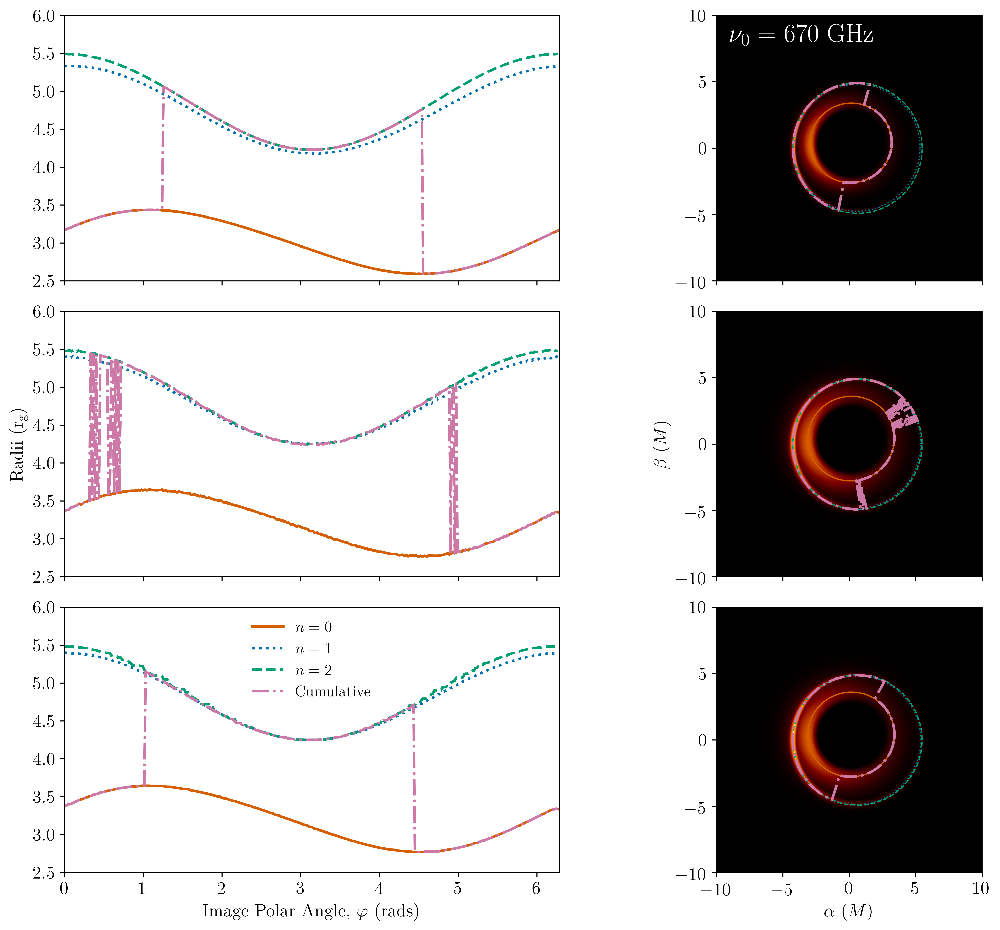

In [95]:
fig, dum = plt.subplots(3, 2, figsize=[12, 10], dpi=600,sharex='col')
fig.tight_layout(w_pad=0,h_pad=.8)
ax0 = plt.subplot(3, 2, 1)
ax1 = plt.subplot(3, 2, 2)
ax2 = plt.subplot(3, 2, 3)
ax3 = plt.subplot(3, 2, 4)
ax4 = plt.subplot(3, 2, 5)
ax5 = plt.subplot(3, 2, 6)


radiiVSVarphi(fig, ax0, ax1, params.limits, Thin_ImageHighRez,average=False)
radiiVSVarphi(fig, ax2, ax3, params.limits, Thin_ImageLowRez,
                           average=False,
                           color_bar=True)
ax1.text(-9, 8, R"$\nu_0=$ 670 GHz" , fontsize=20, color="white")
radiiVSVarphi(fig, ax4, ax5, params.limits, Thin_ImageLowRez,average=True)


# ax0.text(2, 1.01, astroModels.var_label[action["var"]]
#          + str(round(x_variable[i] / astroModels.scale_label[action["var"]], 2))
#          + ' ' + astroModels.units_label[action["var"]], fontsize=12, color="k")

ax2.set_ylabel(R"Radii ($\rm r_g$)")
ax5.set_xlabel(r"$\alpha$" + " " + r"($M$)")
ax4.set_xlabel(R"Image Polar Angle, $\varphi$ (rads)")
ax4.legend(frameon=False)
ax3.set_ylabel(r"$\beta$" + " " + r"($M$)")

plt.savefig(fig_home + "RadVVarph",dpi=600,bbox_inches='tight')


# Blurr

In [16]:
limit = lim0

In [53]:
def fullBlurrImage(ax,Absorbtion_Image,blurr):
    vmax0 = np.nanmax(Absorbtion_Image)

    im = ax.imshow(Absorbtion_Image, vmax=vmax0, origin="lower", cmap="afmhot", extent=[-limit, limit, -limit, limit])
    ax.text(-9, 7, R"$\sigma=$" + str(blurr) + R" $\mu as$", fontsize=12, color="white")
    
    ax.set_xlim(-10, 10)  # units of M
    ax.set_ylim(-10, 10)


In [1]:
current_freq = 230e9

In [18]:
blur0Image = '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelC22/clean/nu0_2.30000e+11'
blur1Image = '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelC22/blurr1/nu0_blurr_2.30000e+11'
blur5Image = '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelC22/blurr5/nu0_blurr_2.30000e+11'
blur10Image = '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelC22/blurr10/nu0_blurr_2.30000e+11'
blur20Image = '/scratch/gpfs/td6241/aart/bigRuns/run2/Data/intensity/ModelC22/blurr20/nu0_blurr_2.30000e+11'


h5f = h5py.File(blur0Image, 'r')
blur0Image = h5f['bghts_full_absorbtion'][:]
h5f.close()

h5f = h5py.File(blur1Image, 'r')
blur1Image = h5f['thick_blurr_image'][:]
h5f.close()

h5f = h5py.File(blur5Image, 'r')
blur5Image = h5f['thick_blurr_image'][:]
h5f.close()

h5f = h5py.File(blur10Image, 'r')
blur10Image = h5f['thick_blurr_image'][:]
h5f.close()


h5f = h5py.File(blur20Image, 'r')
blur20Image = h5f['thick_blurr_image'][:]
h5f.close()


In [19]:
limit =lim0

In [46]:
rsize = image_tools.num_of_radial_points

def radiiProfile(ax,images,mass,color,sigma):
    rmax = images.shape[0] * .4
    peakAbsorb, interpAbsorb = image_tools.radii_of_thetaV2_data(images)
    peaks = peakAbsorb
    interps = interpAbsorb
    x = np.linspace(0, rmax - 1, rsize) * params.dx0
    ptheta = [np.pi]
    colors = [RingStyle["color"][0], RingStyle["color"][1], 'tab:red']
    parg = []
    for L in range(len(ptheta)):
        parg += [image_tools.rad_to_arg(ptheta[L])]

        yplt = jy(interps[parg[L]], current_freq, mass)
        ax.plot(x, yplt, linewidth=2, color=color,
                       label=R"$\sigma= $" + str(sigma))
        # ax.axvline(peaks[parg[L]], color=colors[L],
        #            linewidth=1)
    ax.set_xlabel(R"$R_g$")
    ax.set_xlim(2, 10)
    ax.set_ylim(0, 5e-7)
    ax.set_ylabel(R"$\rm F_\nu$" +  R"$(\rm J_y)$")
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position("right")
    
    # ax.tick_params('y', which="both", labelleft=False)
    # ax.tick_params('x', which="both", labelbottom=False)



In [81]:
def plotCircle(ax,sigma,x,y,line=None):
    center = (x, y)
    radius = sigma / (2*M2uas)
    if line is None:
        width = 1
    else:
        width = line
    circle = Circle(center, radius,fill=False,color="white",linewidth=width)
    ax.add_patch(circle)


In [39]:
one_M = ilp.rg_func(model_bp_dict[i,j]["mass"] * u.g).to(u.m)
M2uas = np.arctan(one_M.value / dBH) / muas_to_rad  # Mass to micro arcseconds


In [65]:
20 / M2uas

5.138934563051491

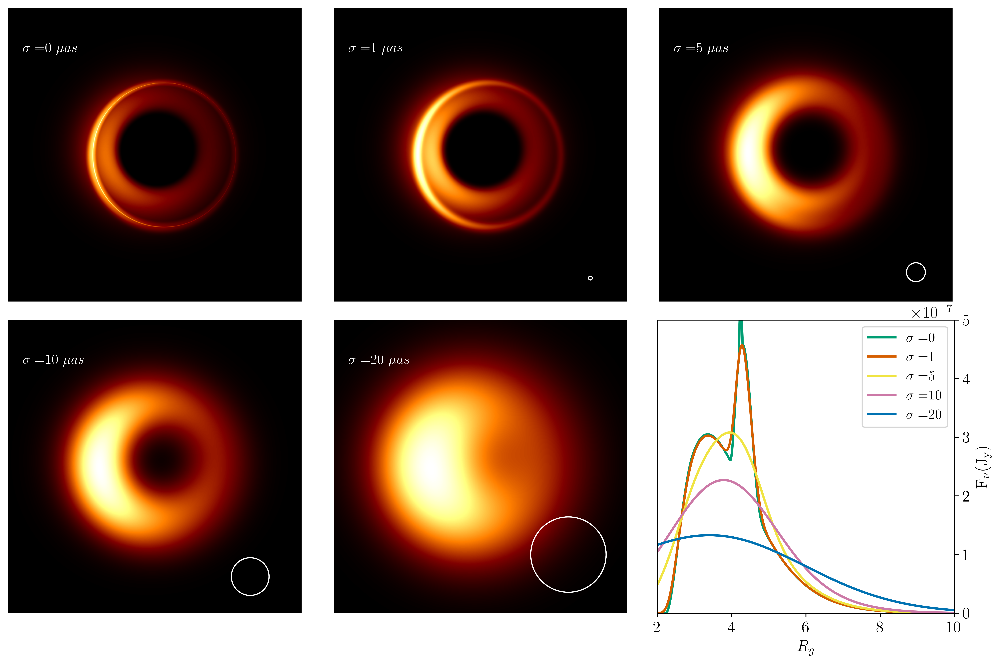

In [84]:
fig, dum = plt.subplots(2, 3, figsize=[12, 8], dpi=600)
fig.tight_layout(w_pad=-2,h_pad=0)
ax0 =  plt.subplot(2,3,1)
ax1 =  plt.subplot(2,3,2)
ax2 =  plt.subplot(2,3,3)
ax3 =  plt.subplot(2,3,4)
ax4 =  plt.subplot(2,3,5)
ax5 =  plt.subplot(2,3,6)
# ax1 = plt.subplot2grid(shape=(3, 3), loc=(0, 0), colspan=3)
# ax1 = plt.subplot2grid(shape=(3, 3), loc=(0, 0), colspan=3)
# ax2 = plt.subplot2grid(shape=(3, 3), loc=(1, 0), colspan=1)
# ax3 = plt.subplot2grid(shape=(3, 3), loc=(1, 2), rowspan=2)
# ax4 = plt.subplot2grid((3, 3), (2, 0))
# ax5 = plt.subplot2grid((3, 3), (2, 1), colspan=1)

ax = [ax0,ax1,ax2,ax3,ax4]
for axs in ax:
    axs.axis('off')

fig.tight_layout(w_pad=0,h_pad=.8)

fullBlurrImage(ax0,blur0Image,0)
fullBlurrImage(ax1,blur1Image,1)
fullBlurrImage(ax2,blur5Image,5)
fullBlurrImage(ax3,blur10Image,10)
fullBlurrImage(ax4,blur20Image,20)


plotCircle(ax1,1,7.5,-8.4,1)
plotCircle(ax2,5,7.5,-8)
plotCircle(ax3,10,6.5,-7.5)
plotCircle(ax4,20,6,-6)

ax4.set_xlabel(r"$\alpha$" + " " + r"($M$)")
ax2.set_ylabel(r"$\beta$" + " " + r"($M$)")

radiiProfile(ax5, blur0Image,model_bp_dict[1,1]["mass"],"#009e73",0)
radiiProfile(ax5, blur1Image,model_bp_dict[1,1]["mass"],"#d55e00",1)
radiiProfile(ax5, blur5Image,model_bp_dict[1,1]["mass"],"#f0e442",5)
radiiProfile(ax5, blur10Image,model_bp_dict[1,1]["mass"],"#cc79a7",10)
radiiProfile(ax5, blur20Image,model_bp_dict[1,1]["mass"],"#0072b2",20)

ax5.legend()
plt.savefig(fig_home + "Blurring",dpi=600,bbox_inches='tight')

# Single Image

In [259]:
def radiiVSVarphi(fig,ax1,limit,thin_intensity,plot_intensites=False,average=True,color_bar=False):
    if plot_intensites:
        peak0, theta0, intent_at_peaks0 = image_tools.radii_of_thetaV2(thin_intensity[0],
                                                                       give_intensities=True,average=average)
        peak1, theta1, intent_at_peaks1 = image_tools.radii_of_thetaV2(thin_intensity[1],
                                                                       give_intensities=True,average=average)
        peak2, theta2, intent_at_peaks2 = image_tools.radii_of_thetaV2(thin_intensity[2],
                                                                       give_intensities=True,average=average)
        peak3, theta3, intent_at_peaks3 = image_tools.radii_of_thetaV2(thin_intensity[3],
                                                                       give_intensities=True,average=average)
        intent_at_peaks = [intent_at_peaks0, intent_at_peaks1, intent_at_peaks2, intent_at_peaks3]
    else:
        peak0, theta0 = image_tools.radii_of_thetaV2(thin_intensity[0],average=average)
        peak1, theta1 = image_tools.radii_of_thetaV2(thin_intensity[1],average=average)
        peak2, theta2 = image_tools.radii_of_thetaV2(thin_intensity[2],average=average)
        peak3, theta3 = image_tools.radii_of_thetaV2(thin_intensity[3],average=average)

    peaks = [peak0,peak1,peak2,peak3]

    thetas = [theta0,theta1,theta2,theta3]

    colors = [RingStyle["color"][0],RingStyle["color"][1],RingStyle["color"][2],RingStyle["color"][3]]
    labels = [R"$n= 0$",R"$n= 1$",R"$n= 2$",R"$Cumulative$"]
    linewidths = [1,1,1,2]
    linestyles = ['-',':','--','-.']
    alphas = []
    betas = []

    for i in range(len(peaks)):
        # if J == 0:
        #     axes_0[J].get_xaxis().set_ticks([])
        #     axes_1[J].get_xaxis().set_ticks([])
        alphas += [peaks[i] * np.cos(thetas[i])]
        betas += [peaks[i] * np.sin(thetas[i])]
            

    im1 = ax1.imshow(thin_intensity[3], origin="lower", cmap="afmhot", extent=[-limit, limit, -limit, limit])

    ax1.set_xlim(-10, 10)  # units of M
    ax1.set_ylim(-10, 10)  # units of M

    # Radii Calc
    for i in range(len(peaks)):
        ax1.plot(alphas[i], betas[i],linewidth=linewidths[i], color=colors[i], linestyle=linestyles[i],label=labels[i])
    

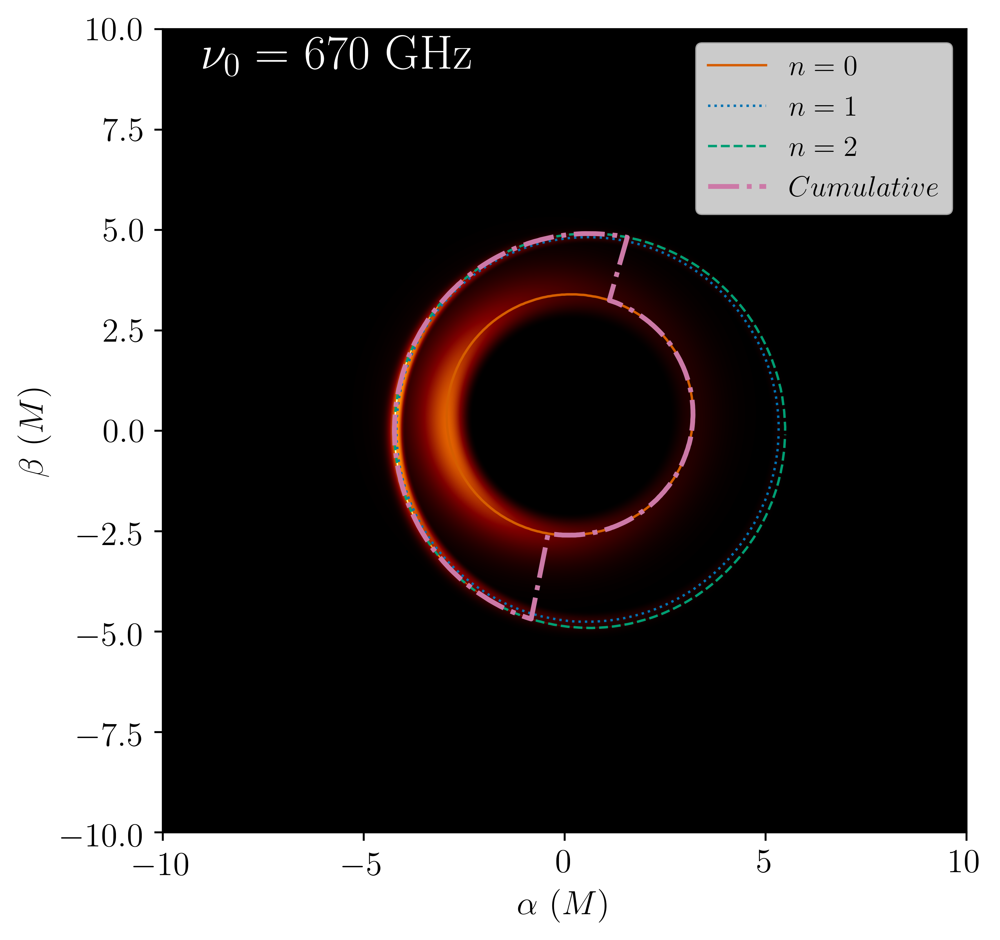

In [260]:
fig, ax = plt.subplots(1, 1, figsize=[6, 6], dpi=600)


radiiVSVarphi(fig, ax, params.limits, Thin_ImageHighRez,average=False)

# ax0.text(2, 1.01, astroModels.var_label[action["var"]]
#          + str(round(x_variable[i] / astroModels.scale_label[action["var"]], 2))
#          + ' ' + astroModels.units_label[action["var"]], fontsize=12, color="k")
ax.text(-9, 9, R"$\nu_0=$ 670 GHz" , fontsize=20, color="white")
ax.set_xlabel(r"$\alpha$" + " " + r"($M$)")
ax.legend()
ax.set_ylabel(r"$\beta$" + " " + r"($M$)")

plt.savefig(fig_home + "SingleImage",dpi=600,bbox_inches='tight')


# Inoisy

In [109]:

brightparams = {
    "p_mag": -1.5,
    "p_temp": -1,
    "p_dens": -.7,
    "n_th0": 1.9e4,
    "t_e0": 1e11,
    "b_0": 5,
    "theta_b": 50.0 * (np.pi / 180),  # NONE VARRYING________________________________________
    "mass": (MMkg * u.kg).to(u.g).value,
    "nu0": 90e9,
    "scale_height": .5,
    "rb_0": 5,
    "beta": 1.0,  # Legacy _____________________________________
    "r_ie": 10.0,
    "nscale": .3
}

funckeys = {
    "emodelkey": 0,  # emodelkey Emission Model choice, 0 = thermal ultrarelativistic, 1 = power law
    "bkey": 2,  # bkey
    "nnoisykey": 1,  # nnoisykey Inoisy density. 0 = no noise, 1 = noise
    "tnoisykey": 1,  # tnoisykey Inoisy temperature
    "bnoisykey": 1  # bnoisykey Inoisy magnetic field
}
args = fileloading.createIntensityArgs(brightparams,lband,rtray,funckeys=funckeys)

In [50]:
print(args)

python3 /home/td6241/repositories/aart/radialintensity.py --nu 230000000000.0 --mass 1.3249659172847406e+43 --scaleh 0.5 --thetab 0.8726646259971648 --beta 1.0 --rie 10.0 --rb0 5 --nth0 19000.0 --te0 100000000000.0 --b0 5 --pdens -0.7 --ptemp -1 --pmag -1.5 --nscale 0.4 --emodelkey 0 --bkey 2 --nnoisykey 1 --tnoisykey 1 --bnoisykey 1 --lband /scratch/gpfs/td6241/aart/bigRuns/run2/Data/geo/ModelCLensing.h5 --rtray /scratch/gpfs/td6241/aart/bigRuns/run2/Data/geo/ModelCRayTracing.h5


In [63]:
subprocess.run([args], shell=True)

/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/kgeo-0.0.1-py3.12.egg/kgeo/bfields.py:158: SyntaxWarning: invalid escape sequence '\m'
/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/kgeo-0.0.1-py3.12.egg/kgeo/bfields.py:183: SyntaxWarning: invalid escape sequence '\m'
/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/kgeo-0.0.1-py3.12.egg/kgeo/bfields.py:158: SyntaxWarning: invalid escape sequence '\m'
/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/kgeo-0.0.1-py3.12.egg/kgeo/bfields.py:183: SyntaxWarning: invalid escape sequence '\m'


Welcome to eht-imaging! v 1.2.7 

using altered rtray
Reading file:  /scratch/gpfs/td6241/aart/bigRuns/run2/Data/geo/ModelCRayTracing.h5
Intensity
using altered lband
Reading file:  /scratch/gpfs/td6241/aart/bigRuns/run2/Data/geo/ModelCLensing.h5
Reading file:  /scratch/gpfs/td6241/aart/bigRuns/run2/Data/geo/ModelCRayTracing.h5
Mask Shape:  (4000000,)
File  /scratch/gpfs/td6241/aart/rawResults/Intensity_a_0.9375_i_17_nu_9.00000e+10_mass_1.32497e+43_scaleh_0.5_thetab_0.873_beta_1.00_rie_10.0_rb_5.0_nth0_1.9e+04_te0_1.0e+11_b0_5.000e+00_pdens_-0.7_ptemp_-1.0_pmag_-1.5_nscale_0.3_emkey_0_bkey_2_nkey_1_tnkey_1_bnkey_1.h5  created.


CompletedProcess(args=['python3 /home/td6241/repositories/aart/radialintensity.py --nu 90000000000.0 --mass 1.3249659172847406e+43 --scaleh 0.5 --thetab 0.8726646259971648 --beta 1.0 --rie 10.0 --rb0 5 --nth0 19000.0 --te0 100000000000.0 --b0 5 --pdens -0.7 --ptemp -1 --pmag -1.5 --nscale 0.3 --emodelkey 0 --bkey 2 --nnoisykey 1 --tnoisykey 1 --bnoisykey 1 --lband /scratch/gpfs/td6241/aart/bigRuns/run2/Data/geo/ModelCLensing.h5 --rtray /scratch/gpfs/td6241/aart/bigRuns/run2/Data/geo/ModelCRayTracing.h5'], returncode=0)

In [112]:
filename = fileloading.intensityNameNoUnits(brightparams,funckeys)

print("Reading file: ", filename)

h5f = h5py.File(filename, 'r')

I0 = h5f['bghts0'][:]  # This implies I0 is 1 pass
I1 = h5f['bghts1'][:]
I2 = h5f['bghts2'][:]

Clean_Absorbtion_Image = h5f['bghts_full_absorbtion'][:]

Clean_Thin_Image = I0+I1+I2

h5f.close()
thin_blurr_image,thick_blurr_image =intensityBlurr.blurrIntensity(brightparams['mass'],Clean_Thin_Image,Clean_Absorbtion_Image, 18)

Reading file:  /scratch/gpfs/td6241/aart/rawResults/Intensity_a_0.9375_i_17_nu_9.00000e+10_mass_1.32497e+43_scaleh_0.5_thetab_0.873_beta_1.00_rie_10.0_rb_5.0_nth0_1.9e+04_te0_1.0e+11_b0_5.000e+00_pdens_-0.7_ptemp_-1.0_pmag_-1.5_nscale_0.3_emkey_0_bkey_2_nkey_1_tnkey_1_bnkey_1.h5


In [31]:
print(np.max(Clean_Thin_Image))
print(np.max(Clean_Absorbtion_Image))

1813263900076.6802
107434836904.05768


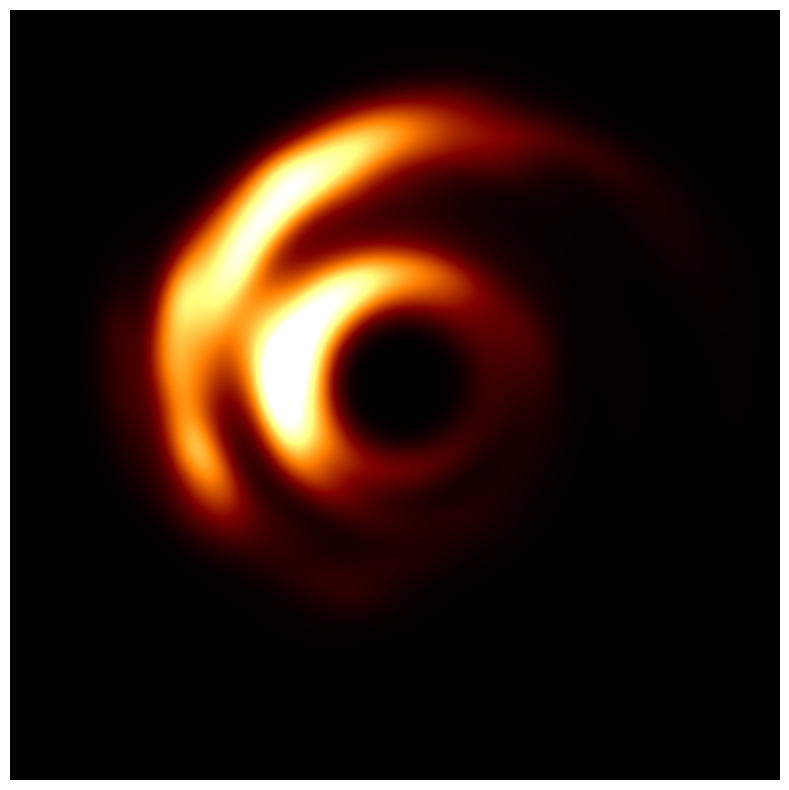

In [49]:
fig, ax = plt.subplots(1,1,figsize=[15, 10])  #, dpi=400
limited = 15
ax.axis("off")
# Subplot 1___________________________________________________
ax  = plt.subplot(1,1,1)
image = thin_blurr_image
ax.imshow(image, vmax=np.max(image)*.7, origin="lower", cmap="afmhot",
          extent=[-lim0, lim0, -lim0, lim0])
ax.set_xlim(-limited, limited)
ax.set_ylim(-limited, limited)

ax.axis("off")
ax.tick_params('x', which="both", labelbottom=False)
ax.tick_params('y', which="both", labelleft=False)

# plt.subplots_adjust(wspace=0.0)
# plt.subplots_adjust(hspace=0.0)
# # fig.tight_layout(w_pad=0,h_pad=0)

plt.subplots_adjust(wspace=-.1, hspace=0)

# plt.savefig(fig_home + "InoisyDUMB",dpi=600,bbox_inches='tight')


Axes(0.547727,0.11;0.352273x0.77)


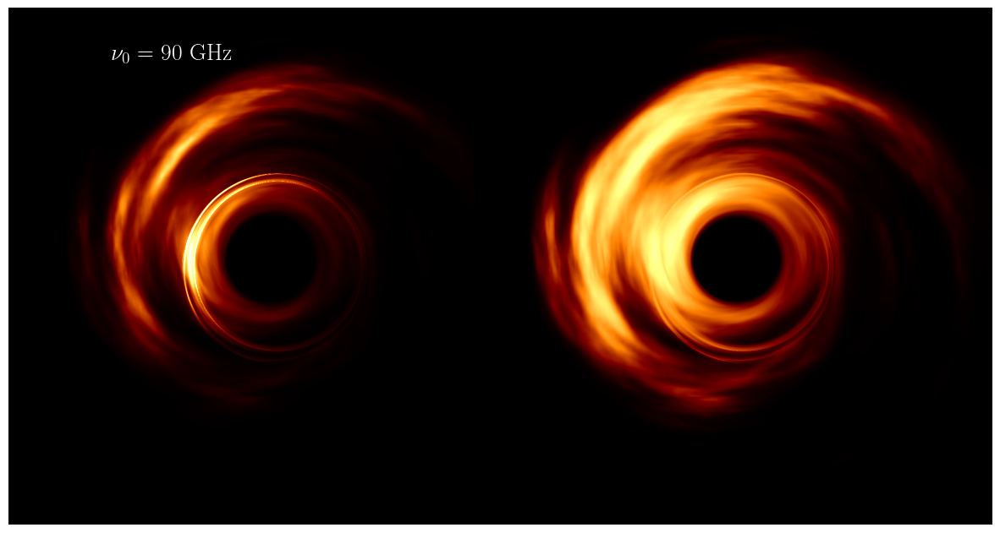

In [262]:
fig, ax = plt.subplots(1,2,figsize=[15, 10])  #, dpi=400
limited = 15
print(ax[1])
ax[0].axis("off")
ax[1].axis("off")
# Subplot 1___________________________________________________
ax[0]  = plt.subplot(1,2,1)
ax[0].imshow(Clean_Thin_Image, vmax=np.max(Clean_Thin_Image)*.5, origin="lower", cmap="afmhot",
          extent=[-lim0, lim0, -lim0, lim0])

ax[0].text(-9, 12, R"$\nu_0=$ 90 GHz" , fontsize=20, color="white")

ax[0].set_xlim(-limited, limited)
ax[0].set_ylim(-limited, limited)

ax[0].axis("off")
ax[0].tick_params('x', which="both", labelbottom=False)
ax[0].tick_params('y', which="both", labelleft=False)

#plt.savefig('BHImage.png',dpi=400,bbox_inches='tight')
# Subplot 2___________________________________________________
ax[1]  = plt.subplot(1,2,2)
ax[1].imshow(Clean_Absorbtion_Image, vmax=np.max(Clean_Absorbtion_Image) * 1.2, origin="lower", cmap="afmhot",
          extent=[-lim0, lim0, -lim0, lim0])

ax[1].set_xlim(-limited, limited)
ax[1].set_ylim(-limited, limited)


ax[1].tick_params('x', which="both", labelbottom=False)
ax[1].tick_params('y', which="both", labelleft=False)
ax[1].axis("off")

# plt.subplots_adjust(wspace=0.0)
# plt.subplots_adjust(hspace=0.0)
# # fig.tight_layout(w_pad=0,h_pad=0)

plt.subplots_adjust(wspace=-.1, hspace=0)

plt.savefig(fig_home + "Inoisy",dpi=600,bbox_inches='tight')


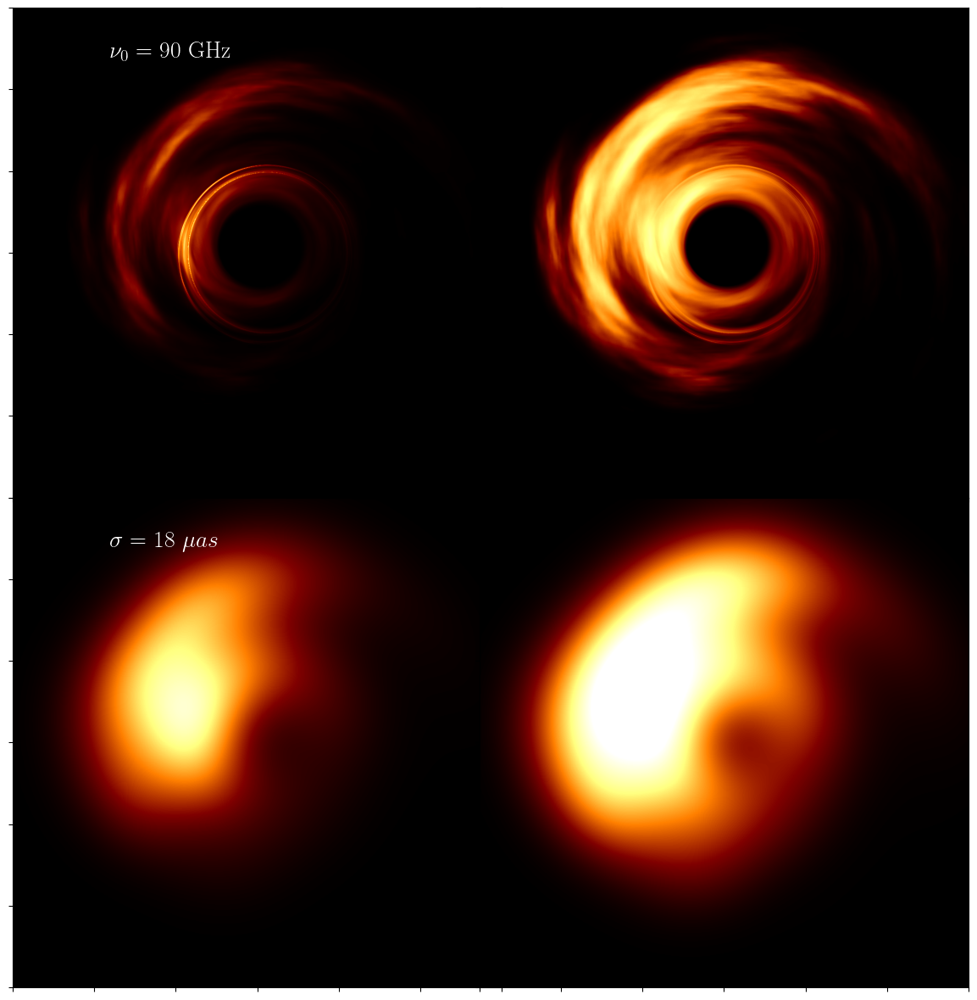

In [116]:
fig, ax = plt.subplots(2,2,figsize=[15, 15])  #, dpi=400
limited = 15

ax = [None, None]
# Subplot 1___________________________________________________
ax[0]  = plt.subplot(2,2,1)
ax[0].imshow(Clean_Thin_Image, vmax=np.max(Clean_Thin_Image) * .8, origin="lower", cmap="afmhot",
          extent=[-lim0, lim0, -lim0, lim0])

ax[0].text(-9, 12, R"$\nu_0=$ 90 GHz" , fontsize=20, color="white")

ax[0].set_xlim(-limited, limited)
ax[0].set_ylim(-limited, limited)


ax[0].tick_params('x', which="both", labelbottom=False)
ax[0].tick_params('y', which="both", labelleft=False)

#plt.savefig('BHImage.png',dpi=400,bbox_inches='tight')
# Subplot 2___________________________________________________
ax[1]  = plt.subplot(2,2,2)
ax[1].imshow(Clean_Absorbtion_Image, vmax=np.max(Clean_Absorbtion_Image) * 1.2, origin="lower", cmap="afmhot",
          extent=[-lim0, lim0, -lim0, lim0])

ax[1].set_xlim(-limited, limited)
ax[1].set_ylim(-limited, limited)


ax[1].tick_params('x', which="both", labelbottom=False)
ax[1].tick_params('y', which="both", labelleft=False)



# Subplot 3___________________________________________________
ax[1]  = plt.subplot(2,2,3)
ax[1].imshow(thin_blurr_image, vmax=np.max(thin_blurr_image) * 1.1, origin="lower", cmap="afmhot",
          extent=[-lim0, lim0, -lim0, lim0])

ax[1].set_xlim(-limited, limited)
ax[1].set_ylim(-limited, limited)

ax[1].text(-9, 12, R"$\sigma=$ 18 $\mu as$" , fontsize=20, color="white")

ax[1].tick_params('x', which="both", labelbottom=False)
ax[1].tick_params('y', which="both", labelleft=False)

# Subplot 3___________________________________________________

ax[1]  = plt.subplot(2,2,4)
ax[1].imshow(thick_blurr_image, vmax=np.max(thick_blurr_image) * .8, origin="lower", cmap="afmhot",
          extent=[-lim0, lim0, -lim0, lim0])

ax[1].set_xlim(-limited, limited)
ax[1].set_ylim(-limited, limited)


ax[1].tick_params('x', which="both", labelbottom=False)
ax[1].tick_params('y', which="both", labelleft=False)


# plt.subplots_adjust(wspace=0.0)
# plt.subplots_adjust(hspace=0.0)
# # fig.tight_layout(w_pad=0,h_pad=0)

plt.subplots_adjust(wspace=-.1, hspace=0)

plt.savefig(fig_home + "Inoisy",dpi=600,bbox_inches='tight')


# Alter Spin

In [119]:


current_geo_model = fileloading.totalModelNametoGridModel("ModelA22",bigRun.run_type)
fileloading.loadGeoModel(current_geo_model, run.getRunName())

a = params.spin_case

inc = params.i_case * np.pi / 180  # inclination angle
rh = 1 + np.sqrt(1 - a ** 2)  # event horizon
# angles to sample
varphis = np.linspace(-180, 179, 360) * np.pi / 180

# generate outer shadow (n=inf) curve with kgeo
data_outer = kgeo.equatorial_lensing.rho_of_req(a, inc, rh, mbar=5, varphis=varphis)
(_, rhos_outer, alphas_outer, betas_outer) = data_outer

r_outerA = image_tools.curve_params(varphis, rhos_outer)

#_________________________________________________________________________________________


current_geo_model = fileloading.totalModelNametoGridModel("ModelB22",bigRun.run_type)
fileloading.loadGeoModel(current_geo_model, run.getRunName())

a = params.spin_case

inc = params.i_case * np.pi / 180  # inclination angle
rh = 1 + np.sqrt(1 - a ** 2)  # event horizon
# angles to sample
varphis = np.linspace(-180, 179, 360) * np.pi / 180

# generate outer shadow (n=inf) curve with kgeo
data_outer = kgeo.equatorial_lensing.rho_of_req(a, inc, rh, mbar=5, varphis=varphis)
(_, rhos_outer, alphas_outer, betas_outer) = data_outer

r_outerB = image_tools.curve_params(varphis, rhos_outer)

#_________________________________________________________________________________________
current_geo_model = fileloading.totalModelNametoGridModel("ModelC22",bigRun.run_type)
fileloading.loadGeoModel(current_geo_model, run.getRunName())

a = params.spin_case

inc = params.i_case * np.pi / 180  # inclination angle
rh = 1 + np.sqrt(1 - a ** 2)  # event horizon
# angles to sample
varphis = np.linspace(-180, 179, 360) * np.pi / 180

# generate outer shadow (n=inf) curve with kgeo
data_outer = kgeo.equatorial_lensing.rho_of_req(a, inc, rh, mbar=5, varphis=varphis)
(_, rhos_outer, alphas_outer, betas_outer) = data_outer

r_outerC = image_tools.curve_params(varphis, rhos_outer)

#_________________________________________________________________________________________



Loading ModelA

file /scratch/gpfs/td6241/aart/bigRuns/run2/geoModels/ModelA.py Loaded as /home/td6241/repositories/aart/params.py

Loading ModelB

file /scratch/gpfs/td6241/aart/bigRuns/run2/geoModels/ModelB.py Loaded as /home/td6241/repositories/aart/params.py

Loading ModelC

file /scratch/gpfs/td6241/aart/bigRuns/run2/geoModels/ModelC.py Loaded as /home/td6241/repositories/aart/params.py


In [120]:
ModelA22 = runDataClass.SingleModelData(bigRun.getSubPaths(),run.getRunName(),"ModelA22",frequency_points)
ModelB22 = runDataClass.SingleModelData(bigRun.getSubPaths(),run.getRunName(),"ModelB22",frequency_points)
ModelC22 = runDataClass.SingleModelData(bigRun.getSubPaths(),run.getRunName(),"ModelC22",frequency_points)

spinModels = [ModelA22,ModelB22,ModelC22]

meanRadiiThicks = [None,None,None]
spinXaxis = [None,None,None]
conv = [None,None,None]
fluxPeaks = [None,None,None]
r_outers = [r_outerA,r_outerB,r_outerC]

num_of_observation_points = 1000
percent_diff = 2
stop = 670e9
start = action["start"]
points = num_of_observation_points - 1
step = (stop - start)/points
coords = np.linspace(action["start"],670e9,num_of_observation_points) / 1e9


for i in range (len(spinModels)):
    
        

    spinXaxis[i] = spinModels[i]["x_variable"] / astroModels.scale_label["nu0"]
    meanRadiiThicks[i] = spinModels[i]["mean_radii_Thick"]
    
    cumu_interp = interp1d(spinXaxis[i], meanRadiiThicks[i][:, 3])(coords)
    n2_interp = interp1d(spinXaxis[i], meanRadiiThicks[i][:, 2])(coords)
    conv[i] = (start + step * ilp.ring_convergance(n2_interp, cumu_interp,percent_diff))/ astroModels.scale_label[action['var']]
    
    spinjanksysThick = spinModels[i]["janksys_thick"] 
    janksy_interp = interp1d(spinXaxis[i],spinjanksysThick[:, 3])(coords)
    fluxPeaks[i] = (start + step * np.argmax(janksy_interp)) / astroModels.scale_label[action['var']]
    



In [121]:
def radiiVersusFreq2(ax,xaxis,mean_radii,conv_1=None,flux_peak=None,r_outer=None):
    
    if conv_1 is not None:
        ax.axvline(conv_1,
                   color=conv_1_style["color"], 
                   linestyle=conv_1_style["linestyle"], 
                   linewidth=conv_1_style["linewidth"]
                  )
    
    if flux_peak is not None:
        ax.axvline(flux_peak, color=flux_peak_style["color"], 
                   linestyle=flux_peak_style["linestyle"], 
                   linewidth=flux_peak_style["linewidth"]
                  )
    
    if r_outer is not None:
        ax.axhline(r_outer,
                   color=r_outer_style["color"],
                   linestyle=r_outer_style["linestyle"], 
                   linewidth=r_outer_style["linewidth"],
                   alpha=0.3
                  )


    amount_to_plot = 4

    for i in reversed(range(amount_to_plot)):
        ax.plot(xaxis, mean_radii[:, i],
                 "-", 
                 label=RingStyle["label"][i],
                 color=RingStyle["color"][i], 
                 linewidth=RingStyle["linewidth"][i])


    # Labels
    # ax.set_xlabel(astroModels.var_label["nu0"].replace('=', '')
    #                + ' (' + astroModels.units_label["nu0"] + ')')
    ax.set_xscale('log')
    ax.set_yscale('log')

    ax.xaxis.set_minor_formatter(ticker.FormatStrFormatter('%.0f'))
    ax.xaxis.set_major_formatter(ticker.FormatStrFormatter("%.0f"))
    ax.yaxis.set_minor_formatter(ticker.FormatStrFormatter('%.1f'))
    ax.yaxis.set_major_formatter(ticker.FormatStrFormatter("%.1f"))
    
    if flux_peak is not None:
        if np.abs(conv_1 - flux_peak) > 40:
            new_ticks = [xaxis[0], 230, conv_1, flux_peak, xaxis[xaxis.size - 1]]
        else:
            new_ticks = [xaxis[0], 230, flux_peak, xaxis[xaxis.size - 1]]
    else:
        new_ticks = [xaxis[0], 230, xaxis[xaxis.size - 1]]
    ax.set_xticks(new_ticks)
    
#     if r_outer is not None:
#         new_ticks = [xaxis[0], 230, xaxis[xaxis.size - 1]]
#     ax.set_yticks(new_ticks)

    new_ticks = np.append(ax.get_yticks(), r_outer)
    # new_ticks = np.append(new_ticks, r_inner)
    # print(new_ticks)
    ax.set_yticks(new_ticks)
    n = 4  # Keeps every 4th label
    [l.set_visible(False) for (i, l) in enumerate(ax.xaxis.get_minorticklabels()) if i % n != 0]
    ax.set_xlim(xaxis[0], xaxis[xaxis.size - 1])

#     ax.set_ylim(0, 6)
    
    # ax.tick_params('y', which="both", labelleft=False)

    
    ax.tick_params('x', which="both", labelbottom=True)
    n = 6  # Keeps every 4th label
    [l.set_visible(False) for (i, l) in enumerate(ax.xaxis.get_minorticklabels()) if i % n != 0]
    ax.tick_params('x', 
          length=xTickParams["length"], 
          width=xTickParams["width"], 
          which=xTickParams["which"], 
          labelrotation=xTickParams["labelrotation"])

    # ax.tick_params('x', length=20, width=1, which='major', labelrotation=80)

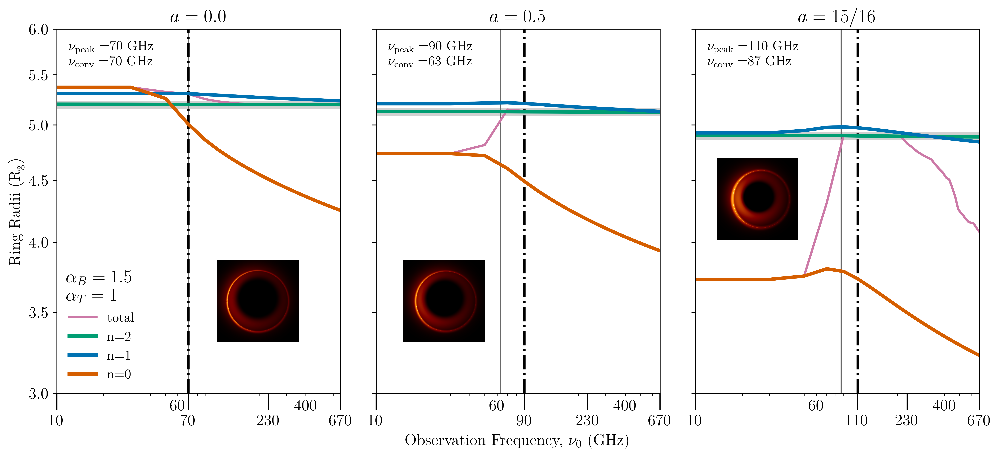

In [225]:

fig, ax = plt.subplots(1, 3, figsize=[12,5], dpi=600,sharey="row")
# fig.suptitle('Full Solution', fontsize=16,y=1.03)

# ax = [None,None,None]
fig.tight_layout(pad=.5)


# Subplot 1____________________________________________________________________________
i=0
# ax[i] = plt.subplot(1,3,i+1)
radiiVersusFreq2(ax[i] ,
                spinXaxis[i],
                meanRadiiThicks[i],
                conv[i],
                fluxPeaks[i],
                r_outers[i]
               )
ax[i].set_title(R"$a=0.0$")
ax[i].text(11.5, 3.58, R"$\alpha_B=1.5$" + "\n" + R" $\alpha_T=1$" , fontsize=16, color="k")

        
text = R"$\nu_{\rm peak}=$" + str("{:.0f}".format(fluxPeaks[i]))+ ' ' + astroModels.units_label["nu0"] + "\n"  + R"$\nu_{\rm conv}=$" + str("{:.0f}".format(conv[i])) + ' ' + astroModels.units_label["nu0"]
ax[i].text(12, 5.6, text , fontsize=12, color="k")



# spinFullImage[1,1]
# spinFullImage[2,1]

newax = fig.add_axes([.2,.2,0.2,0.2], anchor='SW', zorder=1)
newax.imshow(spinFullImage[0,1], vmax=np.max(spinFullImage[0,1]) * 1.2, origin="lower", cmap="afmhot",
           extent=[-lim0, lim0, -lim0, lim0])
newax.axis('off')
limited=7
newax.set_xlim(-limited, limited)
newax.set_ylim(-limited, limited)

# # Subplot 2____________________________________________________________________________

i=1
# ax[i] = plt.subplot(1,3,i+1,sharey=ax[0])

radiiVersusFreq2(ax[i] ,
                spinXaxis[i],
                meanRadiiThicks[i],
                conv[i],
                fluxPeaks[i],
                r_outers[i]
               )
ax[i].set_title(R"$a=0.5$")
        
text = R"$\nu_{\rm peak}=$" + str("{:.0f}".format(fluxPeaks[i]))+ ' ' + astroModels.units_label["nu0"] + "\n"  + R"$\nu_{\rm conv}=$" + str("{:.0f}".format(conv[i])) + ' ' + astroModels.units_label["nu0"]
ax[i].text(12, 5.6, text , fontsize=12, color="k")

newax = fig.add_axes([.39,.2,0.2,0.2], anchor='SW', zorder=1)
newax.imshow(spinFullImage[1,1], vmax=np.max(spinFullImage[1,1]) * 1.2, origin="lower", cmap="afmhot",
           extent=[-lim0, lim0, -lim0, lim0])
newax.axis('off')
limited=7
newax.set_xlim(-limited, limited)
newax.set_ylim(-limited, limited)
# Subplot 3____________________________________________________________________________

i=2
# ax[i] = plt.subplot(1,3,i+1,sharey=ax[0])
radiiVersusFreq2(ax[i] ,
                spinXaxis[i],
                meanRadiiThicks[i],
                conv[i],
                fluxPeaks[i],
                r_outers[i]
               )
ax[i].set_title(R"$a=15/16$")
        
text = R"$\nu_{\rm peak}=$" + str("{:.0f}".format(fluxPeaks[i])) + ' ' + astroModels.units_label["nu0"]+ "\n"  + R"$\nu_{\rm conv}=$" + str("{:.0f}".format(conv[i])) + ' ' + astroModels.units_label["nu0"]
ax[i].text(12, 5.6, text , fontsize=12, color="k")

newax = fig.add_axes([.71,.45,0.2,0.2], anchor='SW', zorder=1)
newax.imshow(spinFullImage[2,1], vmax=np.max(spinFullImage[2,1]) * 1.2, origin="lower", cmap="afmhot",
           extent=[-lim0, lim0, -lim0, lim0])
newax.axis('off')
limited=7
newax.set_xlim(-limited, limited)
newax.set_ylim(-limited, limited)




#         if k == 4:
ax[0].set_ylabel("Ring Radii ({})".format(R'$\rm R_g$'))
            
#         if k == 7:
ax[0].legend(frameon=False)

#         if k == 8:
ax[1].set_xlabel(R"Observation Frequency, $\nu_0$ (GHz)")

ax[0].tick_params('y', which="both", labelleft=True)

ax[0].set_ylim(3,6)
ax[0].yaxis.set_major_locator(MultipleLocator(.5))

plt.savefig(fig_home + "SpinThickRadiiVNuRow",dpi=600,bbox_inches='tight')

# MovieMaker

In [103]:

arg = 'python /home/td6241/repositories/aart/Movie_Maker/moviemakerpresent.py 0 10e9 700e9 20e9 .4'
subprocess.run([arg], shell=True)


/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/kgeo-0.0.1-py3.12.egg/kgeo/bfields.py:158: SyntaxWarning: invalid escape sequence '\m'
/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/kgeo-0.0.1-py3.12.egg/kgeo/bfields.py:183: SyntaxWarning: invalid escape sequence '\m'
/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/kgeo-0.0.1-py3.12.egg/kgeo/bfields.py:158: SyntaxWarning: invalid escape sequence '\m'
/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/kgeo-0.0.1-py3.12.egg/kgeo/bfields.py:183: SyntaxWarning: invalid escape sequence '\m'


Welcome to eht-imaging! v 1.2.7 

using altered rtray
Reading file:  /scratch/gpfs/td6241/aart/rawResults/Rays_a_0.9375_i_17.h5
Intensity
using altered lband
Reading file:  /scratch/gpfs/td6241/aart/rawResults/LensingBands_a_0.9375_i_17.h5
Reading file:  /scratch/gpfs/td6241/aart/rawResults/Rays_a_0.9375_i_17.h5
Mask Shape:  (4000000,)
File  /scratch/gpfs/td6241/aart/rawResults/Intensity_a_0.9375_i_17_nu_1.00000e+10_mass_1.32497e+43_scaleh_0.5_thetab_0.873_beta_1.00_rie_10.0_rb_5.0_nth0_1.9e+04_te0_1.0e+11_b0_5.000e+00_pdens_-0.7_ptemp_-1.0_pmag_-1.5_nscale_0.4_emkey_0_bkey_2_nkey_0_tnkey_0_bnkey_0.h5  created.
Reading file:  /scratch/gpfs/td6241/aart/rawResults/LensingBands_a_0.9375_i_17.h5
Reading file:  /scratch/gpfs/td6241/aart/rawResults/Rays_a_0.9375_i_17.h5
Creating Data Set: 0
Reading file:  /scratch/gpfs/td6241/aart/rawResults/Intensity_a_0.9375_i_17_nu_1.00000e+10_mass_1.32497e+43_scaleh_0.5_thetab_0.873_beta_1.00_rie_10.0_rb_5.0_nth0_1.9e+04_te0_1.0e+11_b0_5.000e+00_pdens_-0

Traceback (most recent call last):
  File "/home/td6241/repositories/aart/Movie_Maker/moviemakerpresent.py", line 330, in <module>
    ring_radii_n0_array = np.vstack((ring_radii_n0_array, tls.radii_of_theta(I0, thetapointsamount)))
                                                          ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/td6241/repositories/aart/Movie_Maker/tools.py", line 114, in radii_of_theta
    peak = np.argmax(interp(coords), 1)
                     ^^^^^^^^^^^^^^
  File "/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/scipy/interpolate/_rgi.py", line 329, in __call__
    xi, xi_shape, ndim, nans, out_of_bounds = self._prepare_xi(xi)
                                              ^^^^^^^^^^^^^^^^^^^^
  File "/home/td6241/anaconda3/envs/mural/lib/python3.12/site-packages/scipy/interpolate/_rgi.py", line 383, in _prepare_xi
    raise ValueError("One of the requested xi is out of bounds "
ValueError: One of the requested xi is out of bounds in d

CompletedProcess(args=['python /home/td6241/repositories/aart/Movie_Maker/moviemakerpresent.py 0 10e9 700e9 20e9 .4'], returncode=1)